In [1]:
import neurokit2 as nk
from scipy import signal, stats

from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
from sklearn.calibration import CalibratedClassifierCV
from scipy.signal import find_peaks, savgol_filter
from sklearn.metrics import adjusted_rand_score
from sklearn.naive_bayes import GaussianNB
from sklearn.cluster import KMeans, DBSCAN
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
# import neurokit2 as nk
from tqdm import tqdm
from math import atan, radians
import pandas as pd
import numpy as np
import umap
import h5py

import torch.optim as optim
from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from torch.utils.data import DataLoader, TensorDataset, random_split

import warnings
warnings.filterwarnings("ignore")

In [2]:
def ultra_filter(signals, n=None, channel=None):
    if n == None and channel==None:
        y = signals
    else:
        y = signals[n][channel]

    # 1. Найдем пики
    peaks, _ = find_peaks(y, height=(0.1, 0.5), distance=10)
    peaks = peaks[peaks < len(y)]

    # 2. Найдем тренд с помощью фильтра Савицкого-Голея
    y_trend = savgol_filter(y, window_length=51, polyorder=3)

    # 3. Удалим тренд, чтобы получить колебания (пики и волны)
    y_fluctuations = y - y_trend

    # 4. Обработаем волны (сгладим их)
    y_waves_smoothed = savgol_filter(y_fluctuations, window_length=21, polyorder=2)

    # 5. Восстановим данные, добавив колебания к тренду
    y_restored = y_trend + y_waves_smoothed

    return y_restored

def signal_transform_tensor_1(signals, N=0, max_len_signal=5000, sampling_rate=500):
    """Транформирует сигналы в тензор.\n
    N - номер отведения в соответствии с массивом:\n
    ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']"""

    # Ограничиваем максимальную длину до единого значения для использования в батче.
    # Дописывать нули в конце для одной длины - сомнительная идея для LSTM.

    i = 0

    result_reshape = np.reshape([ultra_filter([float(ss) for ss in signal[i][0:max_len_signal]]) for signal in signals], (1, max_len_signal * len(signals)))
    # result_reshape = np.reshape([[float(ss) for ss in signal[i][0:max_len_signal]] for signal in signals], (1, max_len_signal * len(signals)))

    return torch.tensor(result_reshape, dtype=torch.float32).reshape((1, len(signals), max_len_signal)).permute((1,2,0))

def signal_transform_tensor_1_non_fixed(signals, N=0, sampling_rate=500, scaler=None):
    """Транформирует сигналы в тензор.\n
    N - номер отведения в соответствии с массивом:\n
    ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']"""

    # Ограничиваем максимальную длину до единого значения для использования в батче.
    # Дописывать нули в конце для одной длины - сомнительная идея для LSTM.

    i = 0

    res = []

    for signal in signals:
        if isinstance(scaler, type(None)):
            res.append(torch.tensor(ultra_filter([float(ss) for ss in signal[i]]), dtype=torch.float32))
        else:
            # torch.tensor(ultra_filter([float(ss) for ss in signal[i]]), dtype=torch.float32)
            res.append(torch.tensor(scaler.transform(torch.reshape(torch.tensor(ultra_filter([float(ss) for ss in signal[i]]), dtype=torch.float32), (-1, 1)))).flatten())
    
    return res

    # result_reshape = np.reshape([ultra_filter([float(ss) for ss in signal[i]]) for signal in signals], (1, max_len_signal * len(signals)))
    # # result_reshape = np.reshape([[float(ss) for ss in signal[i][0:max_len_signal]] for signal in signals], (1, max_len_signal * len(signals)))

    # return torch.tensor(result_reshape, dtype=torch.float32).reshape((1, len(signals), max_len_signal)).permute((1,2,0))

def label_transform_tensor(labels, all_diagnoses=False):
    """Транформирует лейблы в тензор.\n
    Сейчас только в режиме 'Норма-Не норма'."""

    # TODO: сделать разбиение лейблов на первичное и вторичное заключение врача

    result_labels = []

    if all_diagnoses:
        return None
    
    else:
        # Норма - Не норма
        for label in labels:
            if label == '1':
                result_labels.append(0)
            else:
                result_labels.append(1)

    result_labels = torch.tensor(result_labels, dtype=torch.float32).reshape((len(result_labels), 1))

    print("Label transformed to tensor successfully\n")

    return result_labels

def extract_arythmia_codes(metadata_filepath='code.csv'):
    codes = pd.read_csv(metadata_filepath)
    cat_mas = ['C', 'D', 'E', 'F', 'H']
    mini_codes = codes[codes['Category'].isin(cat_mas)]
    
    mas_ill = [[] for i in range(len(cat_mas))]

    for i in range(len(mini_codes["Category"].to_numpy())):
        for k in range(len(cat_mas)):
            if mini_codes.iloc[i]["Category"] == cat_mas[k]:
                mas_ill[k].append(mini_codes.iloc[i]['Code'])
                break
    
    return mas_ill
    # return mini_codes['Code'].to_numpy().tolist()

def label_transform_arythmia_tensor(labels, all_diagnoses=False, categories=False):
    """Транформирует лейблы в тензор.\n
    Сейчас только в режиме 'Норма-Не норма'."""

    mas_codes = extract_arythmia_codes('../csv/code.csv')
    # mas_codes = mas_codes[0:len(mas_codes) - 3]

    result_labels = []

    if all_diagnoses:
        return None
    
    else:
        # Норма - Не норма
        for label in labels:
            flag = 1
            for i in range(len(mas_codes)):
                if flag:
                    for code in mas_codes[i]:
                        if str.find(label, str(code)) == 0 or str.find(label, str(code)) == 3 or str.find(label, str(code)) == 4:
                            if categories:
                                result_labels.append(i + 1)
                            else:
                                result_labels.append(1)
                            flag = 0
                            break
                if not flag:
                    break
            
            if flag:
                result_labels.append(0)

    result_labels = torch.tensor(result_labels, dtype=torch.float32).reshape((len(result_labels), 1))

    print("Label transformed to tensor successfully\n")

    return result_labels

def ecg_quality_metrics(signal, fs=1000):
    # Очистка сигнала
    cleaned = nk.ecg_clean(signal, sampling_rate=fs)
    
    # Детекция R-пиков
    r_peaks = nk.ecg_findpeaks(cleaned, sampling_rate=fs)['ECG_R_Peaks']
    
    # Расчет SNR
    noise = signal - cleaned
    snr = 10 * np.log10(np.var(cleaned) / np.var(noise))
    
    # Стабильность RR-интервалов
    rr = np.diff(r_peaks) / fs * 1000  # в мс
    cv_rr = (np.std(rr) / np.mean(rr)) * 100  # Коэффициент вариации
    
    # return {"SNR_dB": snr, "RR_CV%": cv_rr}
    return snr, cv_rr

def ecg_quality_metrics_ultra(signal, fs=1000):
    # Очистка сигнала
    cleaned = ultra_filter(signal)
    
    # Детекция R-пиков
    r_peaks = nk.ecg_findpeaks(cleaned, sampling_rate=fs)['ECG_R_Peaks']
    
    # Расчет SNR
    noise = signal - cleaned
    snr = 10 * np.log10(np.var(cleaned) / np.var(noise))
    
    # Стабильность RR-интервалов
    rr = np.diff(r_peaks) / fs * 1000  # в мс
    cv_rr = (np.std(rr) / np.mean(rr)) * 100  # Коэффициент вариации
    
    # return {"SNR_dB": snr, "RR_CV%": cv_rr}
    return snr, cv_rr

def load_data(metadata_filepath='metadata.csv', N_start=0, N_end=10, only_health=False):
    """Загрузка данных из файлов.\n
    Работает только при наличии директории 'records',\n
    в которой пять папок по 5000 файлов записей"""
    
    # Загружаем метаданные и выбираем срезом нужные
    metadata_full = pd.read_csv(metadata_filepath)
    metadata = metadata_full.iloc[N_start:N_end]

    # Убираем лишние столбцы, приводим к типу int32
    metadata = metadata.drop(columns=['Date', 'Patient_ID'])
    metadata['Age'].astype(np.int32)
    metadata['N'].astype(np.int32)

    if only_health:
        # Берём только здоровых людей
        health_metadata = metadata.loc[metadata['AHA_Code'] == '1']
        id_metadata = health_metadata['ECG_ID'].values
        labels = health_metadata['AHA_Code'].values
    else:
        # Берём всех
        id_metadata = metadata['ECG_ID'].values
        labels = metadata['AHA_Code'].values

    signals = []

    for i in id_metadata:
        # Из Axxxxx оставляем численную часть
        number = int(i[1:])

        # В каждой папке 5000 файлов (кроме пятой), поэтому,
        # чтобы узнать номер папки, в которой запись, делим на 5000
        record_num = (number - 1) // 5000
        if record_num > 4:
            record_num = 4
        record_num = record_num + 1
        
        # Считываем файл.
        if record_num == 1:
            file_name_ = f'../records/record{record_num}/{i}.h5'
        else:
            file_name_ = f'../records/records{record_num}/{i}.h5'
        with h5py.File(file_name_, 'r') as f:
            signals.append(f['ecg'][()])
    
    health_n = len(labels[labels == '1'])
    diseased_n = len(labels[labels != '1'])

    print(f"Data loaded successfully.\n\
          Health    number:     {health_n}\n\
          Diseased  number:     {diseased_n}\n\n")

    return signals, labels

def load_data_age_sex(metadata_filepath='metadata.csv', N_start=0, N_end=10, only_health=False):
    """Загрузка данных из файлов.\n
    Работает только при наличии директории 'records',\n
    в которой пять папок по 5000 файлов записей"""
    
    # Загружаем метаданные и выбираем срезом нужные
    metadata_full = pd.read_csv(metadata_filepath)
    metadata = metadata_full.iloc[N_start:N_end]

    # Убираем лишние столбцы, приводим к типу int32
    metadata = metadata.drop(columns=['Date', 'Patient_ID'])
    metadata['Age'].astype(np.int32)
    metadata['N'].astype(np.int32)

    metadata['Sex'].replace({'M': 0, 'F': 1}, inplace=True)

    if only_health:
        # Берём только здоровых людей
        health_metadata = metadata.loc[metadata['AHA_Code'] == '1']
        id_metadata = health_metadata['ECG_ID'].values
        labels = health_metadata['AHA_Code'].values
        ages = health_metadata['Age'].values
        sexs = health_metadata['Sex'].values
    else:
        # Берём всех
        id_metadata = metadata['ECG_ID'].values
        labels = metadata['AHA_Code'].values
        ages = metadata['Age'].values
        sexs = metadata['Sex'].values

    signals = []

    for i in id_metadata:
        # Из Axxxxx оставляем численную часть
        number = int(i[1:])

        # В каждой папке 5000 файлов (кроме пятой), поэтому,
        # чтобы узнать номер папки, в которой запись, делим на 5000
        record_num = (number - 1) // 5000
        if record_num > 4:
            record_num = 4
        record_num = record_num + 1
        
        # Считываем файл.
        if record_num == 1:
            file_name_ = f'../records/record{record_num}/{i}.h5'
        else:
            file_name_ = f'../records/records{record_num}/{i}.h5'
        with h5py.File(file_name_, 'r') as f:
            signals.append(f['ecg'][()])
    
    health_n = len(labels[labels == '1'])
    diseased_n = len(labels[labels != '1'])

    print(f"Data loaded successfully.\n\
          Health    number:     {health_n}\n\
          Diseased  number:     {diseased_n}\n\n")

    return signals, labels, ages, sexs

def delete_bad_snr_db(signals_, labels_, channel_check=0, print_idx=False):
    signals = []
    labels = []
    deleted_idx = []
    ok_idx = []
    
    for i in range(len(signals_)):
        sbr_db, rr = ecg_quality_metrics_ultra(signals_[i][channel_check], 500)
        
        if sbr_db >= 15:
            signals.append(signals_[i])
            labels.append(labels_[i])
            ok_idx.append(i)
        else:
            deleted_idx.append(i)
    
    if print_idx:
        print("deleted indexes:")
        print(*deleted_idx)
    
    print(f"num of left: {len(signals)}")
    
    return signals, labels, ok_idx

def delete_bad_snr_db_ages_sexs(signals_, labels_, ages_=None, sexs_=None, channel_check=0, print_idx=False):
    signals = []
    labels = []
    ages = []
    sexs = []
    deleted_idx = []
    
    for i in range(len(signals_)):
        sbr_db, rr = ecg_quality_metrics_ultra(signals_[i][channel_check], 500)
        
        if sbr_db >= 15:
            signals.append(signals_[i])
            labels.append(labels_[i])
            ages.append(ages_[i])
            sexs.append(sexs_[i])
        else:
            deleted_idx.append(i)
    
    if print_idx:
        print("deleted indexes:")
        print(*deleted_idx)
    
    print(f"num of left: {len(signals)}")
    
    return signals, labels, ages, sexs

def load_markers(npz_path):
    """
    Загружает разметку из NPZ-файла
    Возвращает словарь с:
    - 'files': список имен файлов
    - 'markers': список словарей с маркерами для каждого файла
    - 'sample_rate': частота дискретизации
    """
    data = np.load(npz_path, allow_pickle=True)
    
    result = {
        'files': list(data['files']),
        'markers': list(data['markers']),
        'sample_rate': int(data.get('sample_rate', 500))  # По умолчанию 500 Гц
    }
    
    return result

def find_local_maxima_above_threshold(arr, threshold, delta0=1, delta=4, min_angle=85, sample_freq=500):
    n = len(arr)
    maxima_indices = []
    
    for i in range(n):
        is_max = False
        if n == 0:
            return []
        if n == 1:
            is_max = True
        elif i == 0:
            is_max = arr[i] > arr[i+1]
        elif i == n - 1:
            is_max = arr[i] > arr[i-1]
        else:
            is_max = arr[i] > arr[i-1] and arr[i] > arr[i+1]
        
        if is_max and arr[i] > threshold and i < len(arr) - 1 - delta:
            maxima_indices.append(i)
    
    maxima_indices_angle = []
    angle = radians(min_angle)
    angle_max = radians(90)

    for index in maxima_indices:
        in_angles = [angle < atan((abs(arr[index] - arr[index - delta_]))*sample_freq/delta_) < angle_max and angle < atan((abs(arr[index + delta_] - arr[index]))*sample_freq/delta_) < angle_max for delta_ in range(delta0, delta + 1)]
        if np.all(in_angles):
            maxima_indices_angle.append(index)

    return maxima_indices_angle

def split_into_windows_into(data, labels_, scaler=None, shift=0, auto_dop=0):
    windows = []

    if isinstance(scaler, type(None)):
        scaler = StandardScaler()
        scaler.n_features_in_ = 1
        scaler.feature_names_in_ = 1
        scaler.mean_ = np.array([0])
        scaler.var_ = np.array([1])
        scaler.scale_ = np.array([1])

    labels_ = labels_.flatten()

    labels = []
    r_peaks_all = []
    
    for i in range(len(data)):
        r_reaks = find_local_maxima_above_threshold(data[i], (max(data[i]) - min(data[i]))*0.5 + min(data[i]))
        r_peaks_all.append(r_reaks)
        
        for j in range(len(r_reaks) - 1):
            if r_reaks[j] != r_reaks[j + 1]:
                res = scaler.transform(data[i][r_reaks[j] - shift:r_reaks[j + 1] - shift].reshape(-1, 1)).reshape(-1).tolist()
                for g in range(len(res), auto_dop):
                    res.append(res[-1])
                windows.append(res)
                labels.append(labels_[i])

    result = []
    for i in range(len(windows)):
        # print(torch.tensor(windows[i]).reshape((1, len(windows[i]), 1)).shape)
        result.append(torch.tensor(windows[i]).reshape((1, len(windows[i]), 1)))

    return result, labels, r_peaks_all

def bayes(a_, b_, y_data_):
    y_data_ = y_data_.flatten()
    a = []
    b = []
    y_data = []
    for i in range(len(a_)):
        if not np.isnan(a_[i]) and not np.isnan(b_[i]):
            a.append(a_[i])
            b.append(b_[i])
            y_data.append(y_data_[i])

    nd_embed = np.transpose([a, b])
    model_nb = GaussianNB()
    calibrated_model = CalibratedClassifierCV(model_nb, method='isotonic', cv=5)
    calibrated_model.fit(nd_embed, y_data)
    
    # Получение вероятностей и предсказаний
    probabilities = calibrated_model.predict_proba(nd_embed)
    max_probabilities = np.max(probabilities, axis=1)
    preds = calibrated_model.predict(nd_embed)
    
    # Расчет метрик
    print(f"Accuracy: {accuracy_score(y_data, preds):.2f}")
    print(f"F1-score: {f1_score(y_data, preds, average='weighted'):.2f}")
    print("Confusion Matrix:")
    print(confusion_matrix(y_data, preds))
    
    # Правый график (вероятности)
    plt.scatter(
        a,
        b,
        c=max_probabilities,
        cmap="viridis",
        alpha=0.2,
        vmin=0,
        vmax=1
    )
    plt.show()

def find_R_peaks(data, delta0, delta, min_angle):
    r_peaks_all = []

    for i in range(len(data)):
        r_reaks = find_local_maxima_above_threshold(data[i], (max(data[i]) - min(data[i]))*0.5 + min(data[i]), delta0, delta, min_angle)
        r_peaks_all.append(r_reaks)
    
    return r_peaks_all

def find_Q_peaks(data, all_R_peaks=None):
    if isinstance(all_R_peaks, type(None)):
        all_R_peaks = find_R_peaks(data, 2, 4, 83)
    
    Q_peaks = []

    for k in range(len(all_R_peaks)):
        Q_peaks_ = []
        for R_peak in all_R_peaks[k]:
            for i in range(R_peak, 0, -1):
                if data[k][i] < data[k][i - 1]:
                    Q_peaks_.append(i)
                    break
        Q_peaks.append(Q_peaks_)
    
    return Q_peaks

def find_S_peaks(data, all_R_peaks=None):
    if isinstance(all_R_peaks, type(None)):
        all_R_peaks = find_R_peaks(data, 2, 4, 83)
    
    S_peaks = []

    for k in range(len(all_R_peaks)):
        S_peaks_ = []
        for R_peak in all_R_peaks[k]:
            for i in range(R_peak, len(data[k]) - 1):
                if data[k][i] < data[k][i + 1]:
                    S_peaks_.append(i)
                    break
        S_peaks.append(S_peaks_)
    
    return S_peaks

def visualize_channel_with_peaks(signal, Q_peaks=None, R_peaks=None, S_peaks=None, index=0, channel=0):
    ecg_order = ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']

    plt.rcParams['figure.figsize'] = [14, 4]

    plt.title(ecg_order[channel])
    plt.plot(signal[index])
    plt.title((f'Отведение {ecg_order}'))

    if not isinstance(Q_peaks, type(None)):
        for peak in Q_peaks[index]:
            plt.axvline(peak, color='purple', alpha=0.2)
    
    if not isinstance(R_peaks, type(None)):
        for peak in R_peaks[index]:
            plt.axvline(peak, color='red', alpha=0.2)
    
    if not isinstance(S_peaks, type(None)):
        for peak in S_peaks[index]:
            plt.axvline(peak, color='green', alpha=0.2)

    plt.show()

In [3]:
codes = pd.read_csv("../csv/code.csv")
mini_codes = codes[codes['Category'].isin(['C', 'D', 'E', 'F', 'H'])]
cat_mas = ['C', 'D', 'E', 'F', 'H']

In [4]:
mas_ill = [[] for i in range(len(cat_mas))]

for i in range(len(mini_codes["Category"].to_numpy())):
    for k in range(len(cat_mas)):
        if mini_codes.iloc[i]["Category"] == cat_mas[k]:
            mas_ill[k].append(mini_codes.iloc[i]['Code'])
            break
mas_ill

[[21, 22, 23],
 [30, 31, 36, 37],
 [50, 51, 54],
 [60],
 [80, 81, 82, 83, 84, 85, 86, 87, 88]]

In [5]:
signals, labels = load_data('../csv/metadata.csv', 0, 1000, True)
signals, labels, ok_idx = delete_bad_snr_db(signals, labels)

signals_transformed = signal_transform_tensor_1_non_fixed(signals)

from itertools import chain

flat_list = list(chain(*signals_transformed))

scale_ = np.std(flat_list)
mean_ = np.mean(flat_list)

print("mean: ", mean_)
print("std: ", scale_)
print("var: ", scale_*scale_)

scaler = StandardScaler()
# scaler.fit([flat_list])
scaler.n_features_in_ = 1
scaler.feature_names_in_ = 1
scaler.mean_ = np.array([mean_])
scaler.var_ = np.array([scale_*scale_])
scaler.scale_ = np.array([scale_])

Data loaded successfully.
          Health    number:     515
          Diseased  number:     0


num of left: 382
mean:  0.0002348341
std:  0.09816028
var:  0.009635441


In [6]:
signals, labels = load_data('../csv/metadata.csv', 0, 2000, False)
signals, labels, ok_idx = delete_bad_snr_db(signals, labels)

signals_transformed = signal_transform_tensor_1_non_fixed(signals, scaler=scaler)
labels_transformed = label_transform_tensor(labels)

labels_transformed_arythmia = label_transform_arythmia_tensor(labels)

# signals_transformed_windowed, labels_transformed_windowed, r_peaks_all = split_into_windows_into(signals_transformed, labels_transformed)

Data loaded successfully.
          Health    number:     1047
          Diseased  number:     953


num of left: 1497
Label transformed to tensor successfully

Label transformed to tensor successfully



In [7]:
data_file = pd.read_csv('../csv/metadata.csv')

In [8]:
idx_code = []

for i in range(len(ok_idx)):
    idx_code.append(data_file.iloc[ok_idx[i]]['AHA_Code'])

In [9]:
r_peaks_all = find_R_peaks(signals_transformed, 2, 4, 83)

In [201]:
r_peaks_all_delta = []
means = []
stds = []
vars = []

for r_peaks in r_peaks_all:
    r_peaks_delta = []
    for j in range(len(r_peaks) - 1):
        r_peaks_delta.append(r_peaks[j + 1] - r_peaks[j])
    r_peaks_all_delta.append(r_peaks_delta)
    
    means.append(np.mean(r_peaks_delta))
    stds.append(np.std(r_peaks_delta))
    vars.append(np.var(r_peaks_delta))

0 1 422.84615384615387 13.592113968407473 184.74556213017752


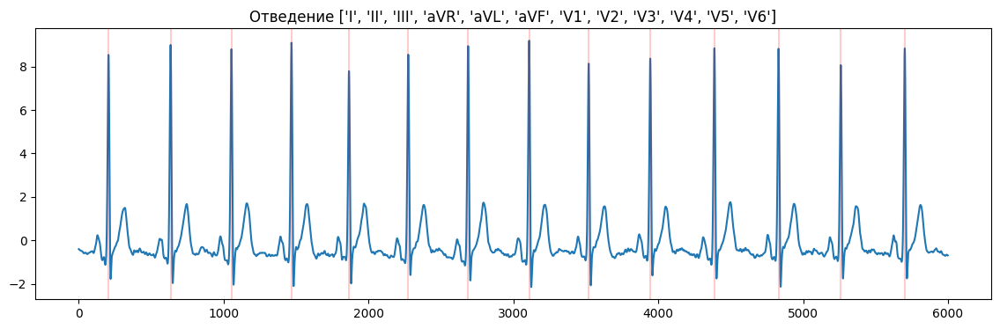

1 146 408.46153846153845 10.645442395080735 113.32544378698228


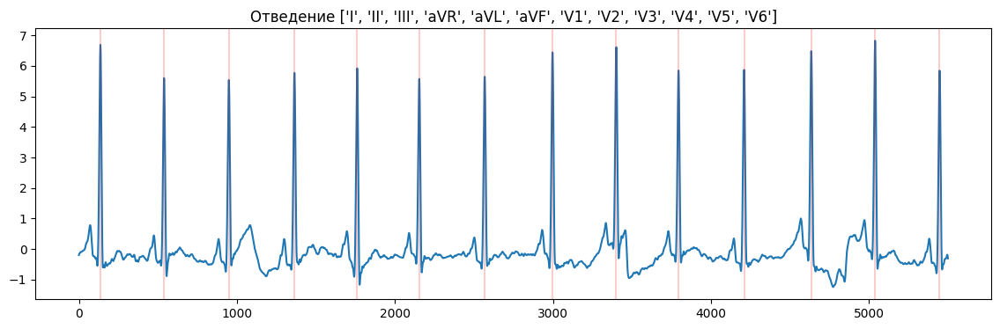

2 106 339.3333333333333 58.22561482906147 3390.2222222222226


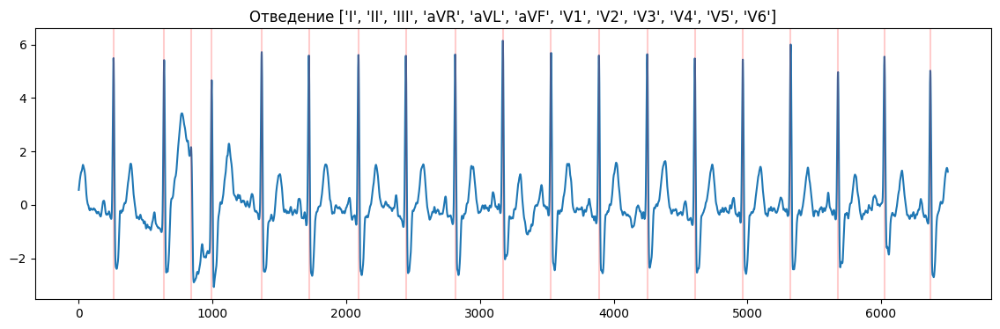

3 1 455.0 32.18384688007324 1035.8


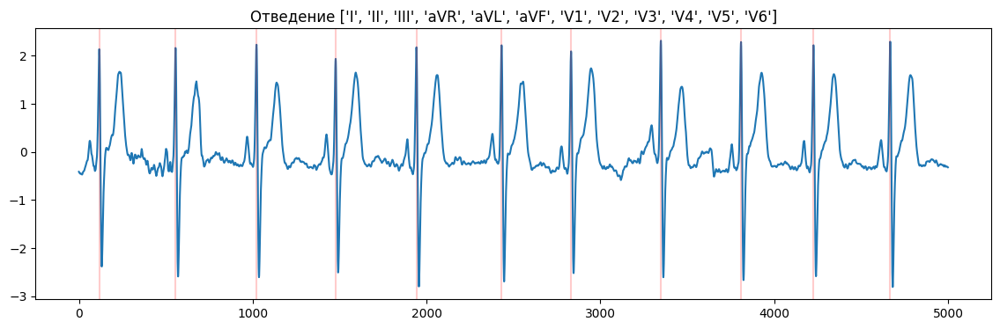

4 1 322.8888888888889 4.852134569088456 23.543209876543212


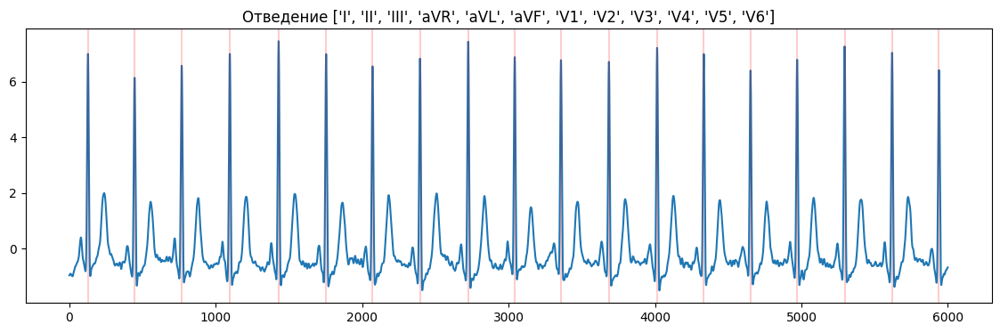

5 1 518.1538461538462 13.03749712793628 169.97633136094674


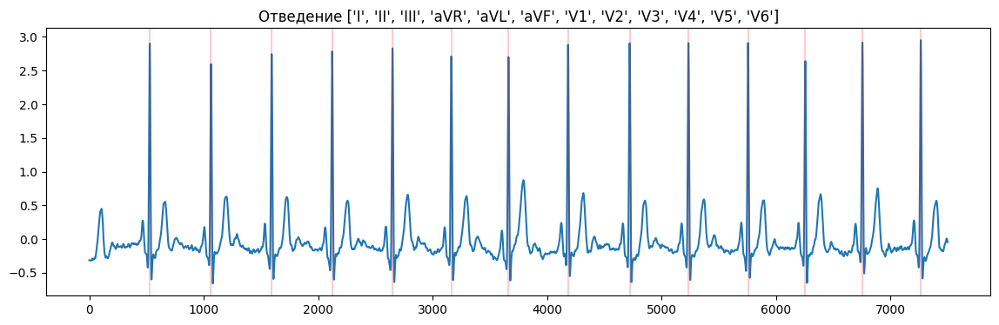

6 22;23 489.55555555555554 24.63110549741305 606.6913580246913


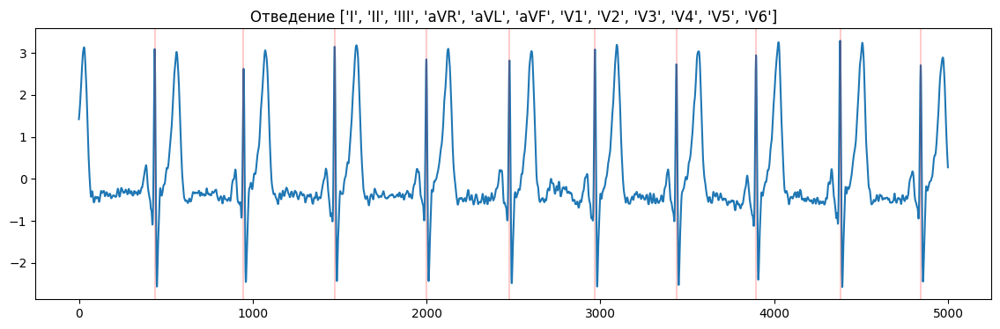

7 1 435.9230769230769 14.53093008014569 211.14792899408283


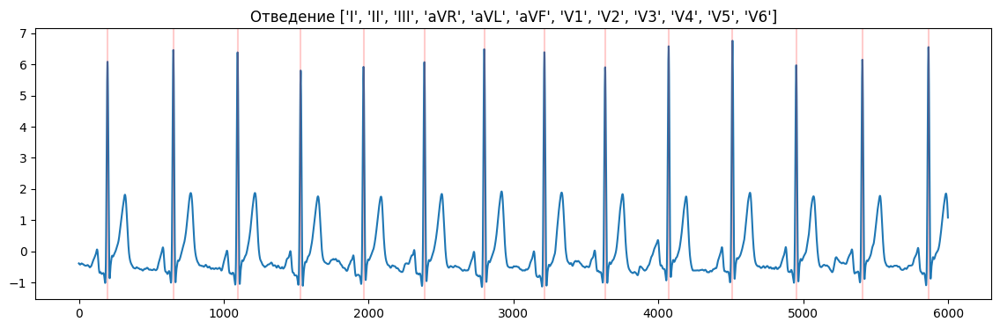

8 30+310 352.35714285714283 129.33323909457258 16727.08673469388


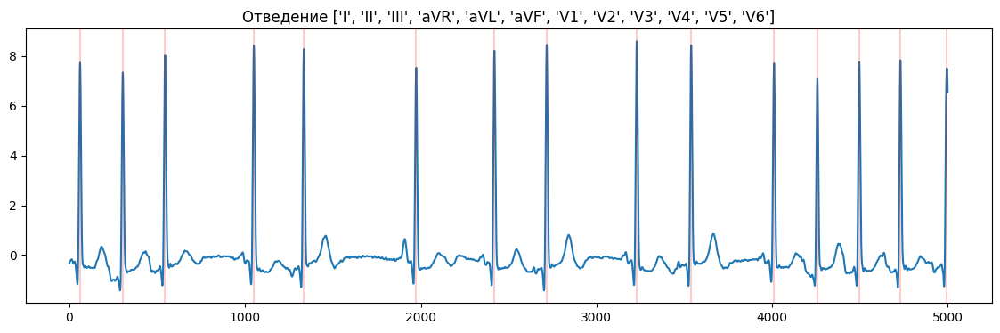

9 1 379.84615384615387 8.742875374983061 76.4378698224852


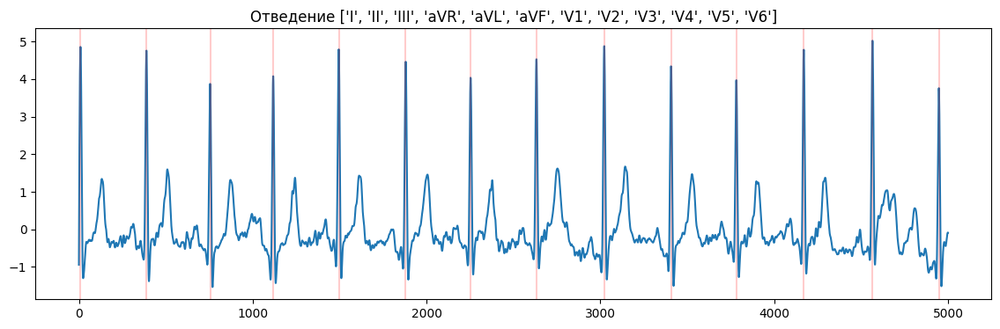

10 22;147 541.7777777777778 10.75771328218634 115.7283950617284


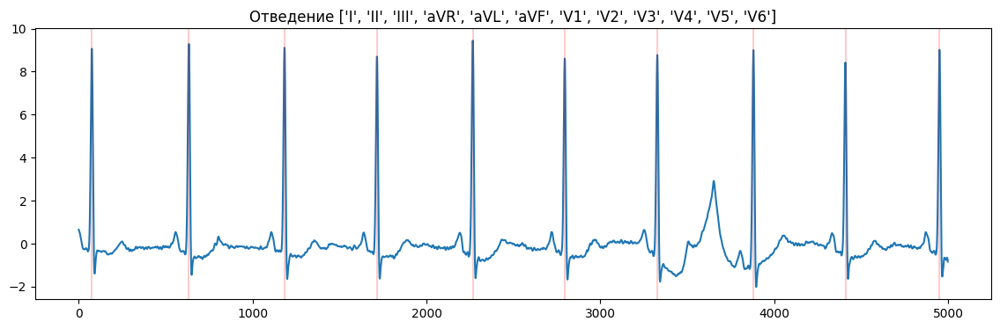

11 1 396.25 19.702474463883973 388.1875


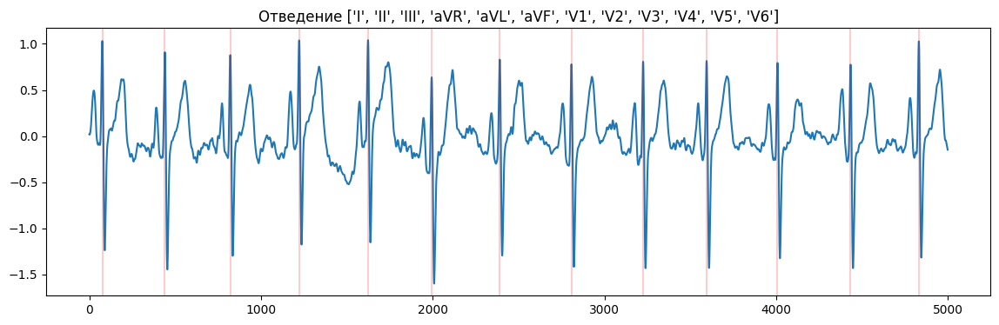

12 60 236.95 112.86960396847329 12739.5475


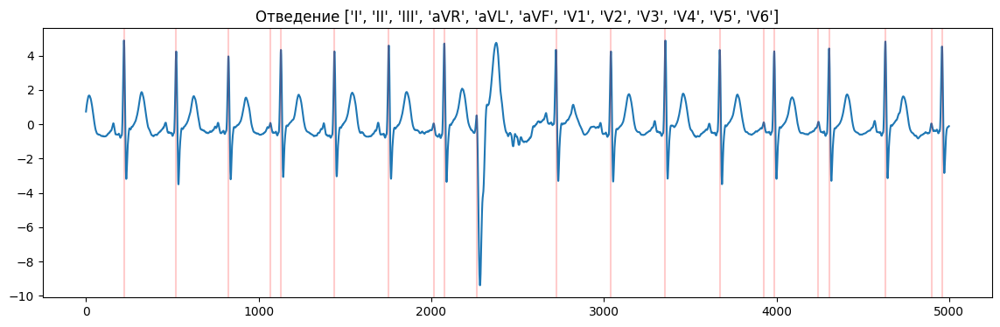

13 30 348.61538461538464 104.28108351325385 10874.544378698223


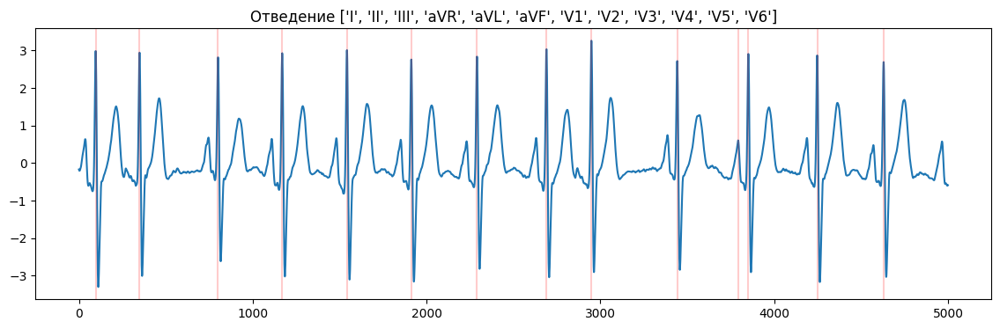

14 1 475.3 15.741982086128798 247.81


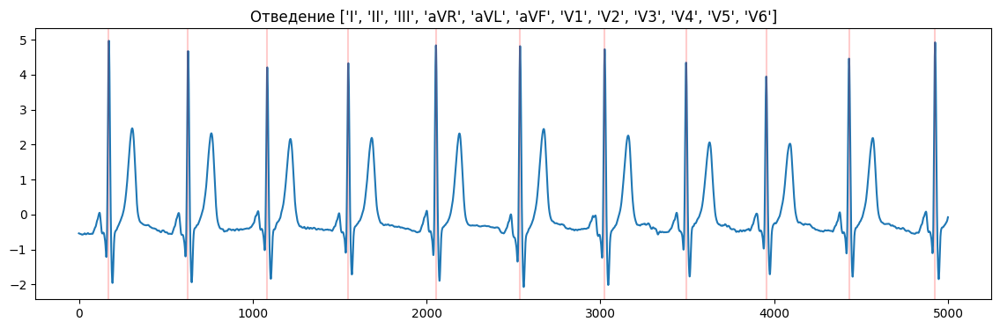

15 125;82 498.22222222222223 4.540625942600567 20.617283950617285


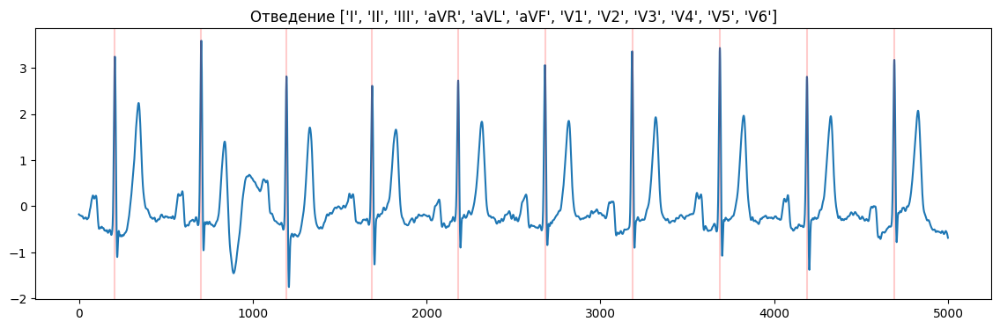

16 105 433.54545454545456 15.089813760906493 227.70247933884295


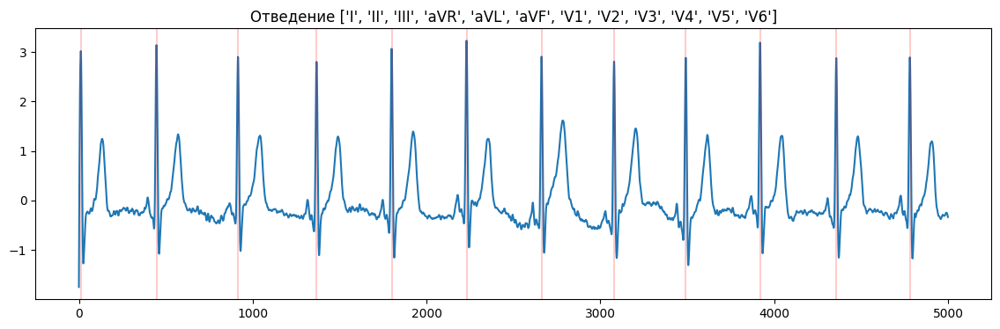

17 1 349.9230769230769 3.384615384615384 11.455621301775146


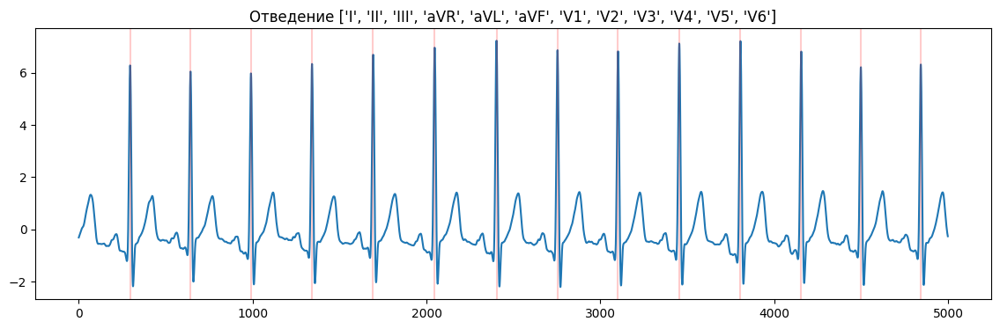

18 1 437.8181818181818 11.043864457188903 121.96694214876032


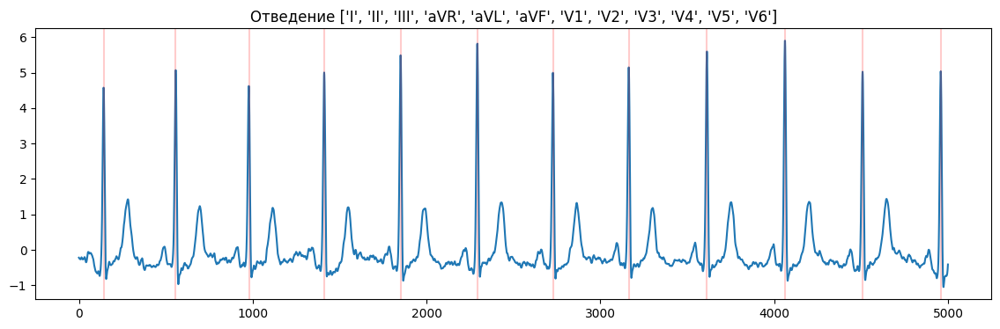

19 1 497.8888888888889 19.034731089624593 362.320987654321


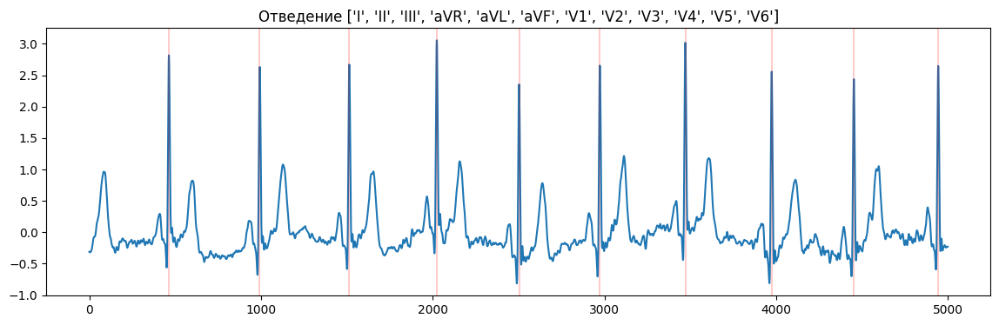

20 1 394.75 13.589977924926883 184.6875


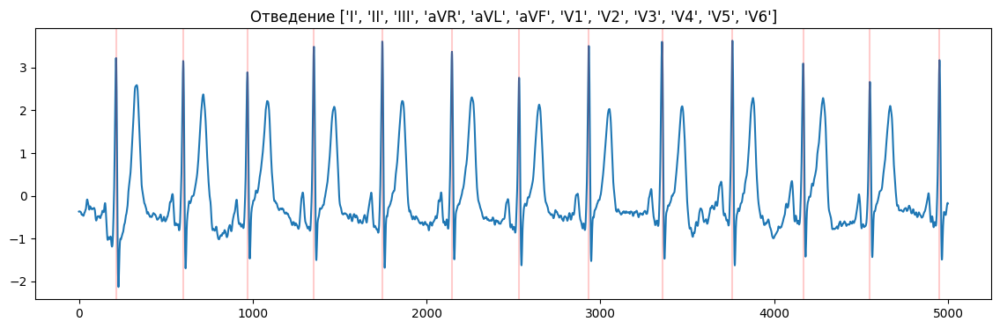

21 1 407.09090909090907 20.2908602149949 411.71900826446284


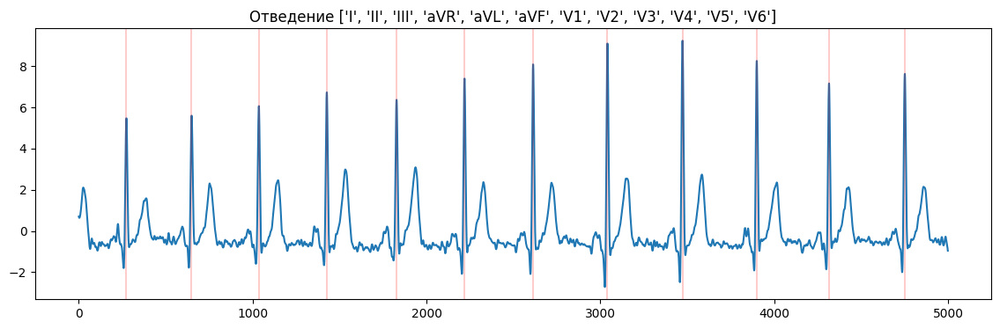

22 105 409.3636363636364 21.406340298114426 458.2314049586776


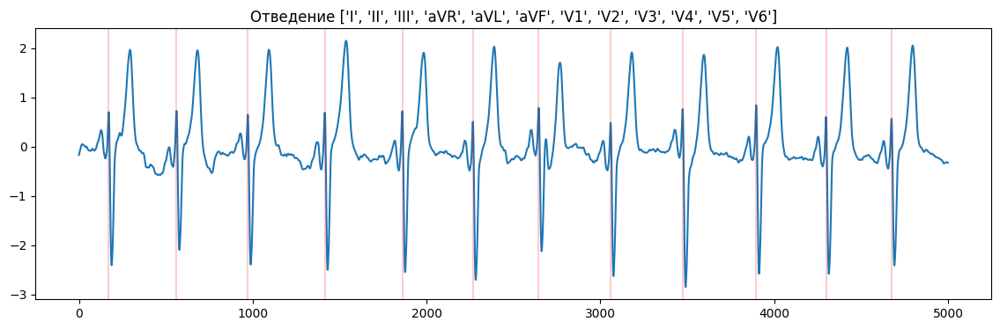

23 22 452.7 142.3144757219026 20253.41


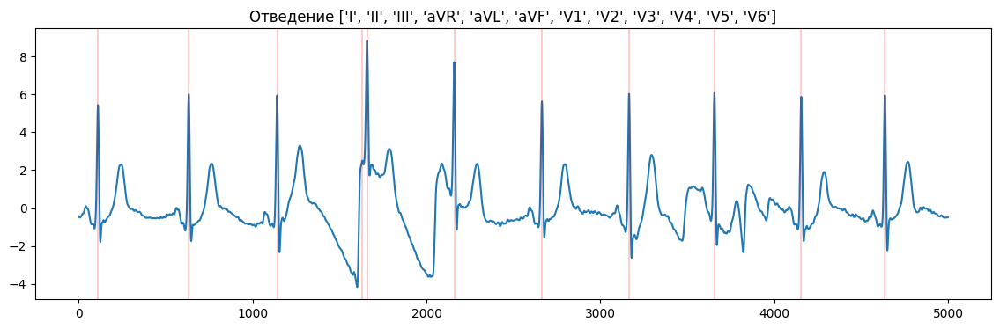

24 1 443.0 4.857983120596447 23.6


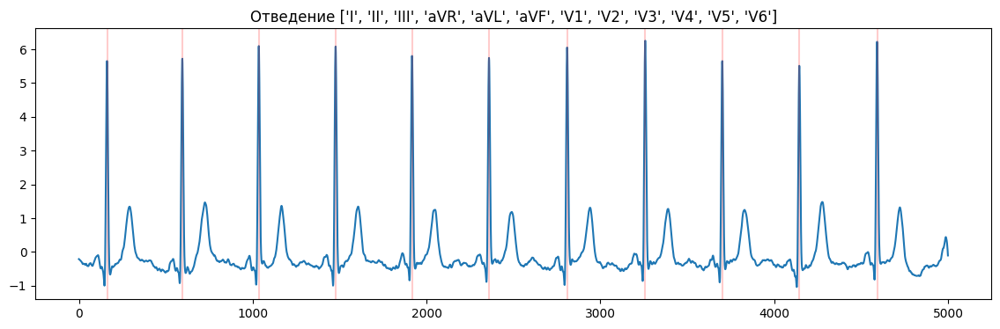

25 1 421.3636363636364 10.27152044399489 105.50413223140498


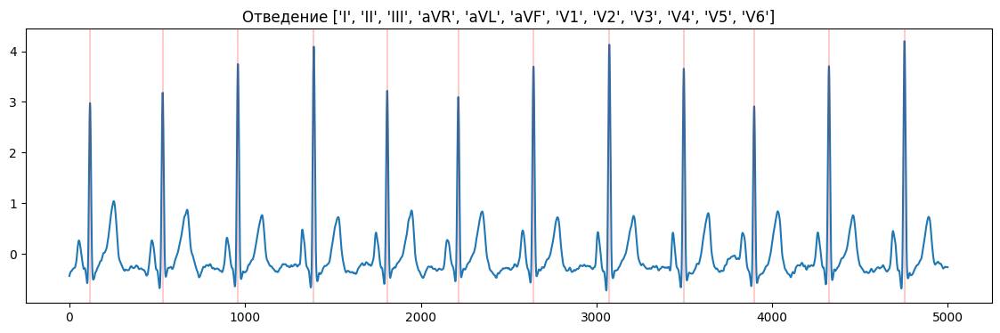

26 60+310 575.0 205.9579245056297 42418.666666666664


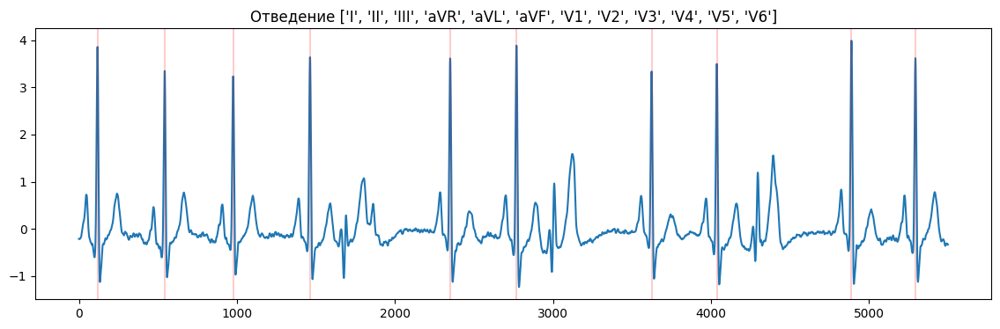

27 23 442.5 26.97498841519677 727.65


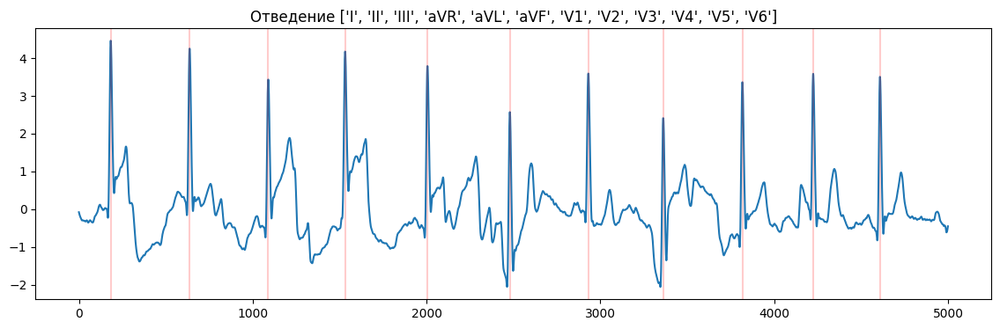

28 1 376.0 16.153113536500538 260.9230769230769


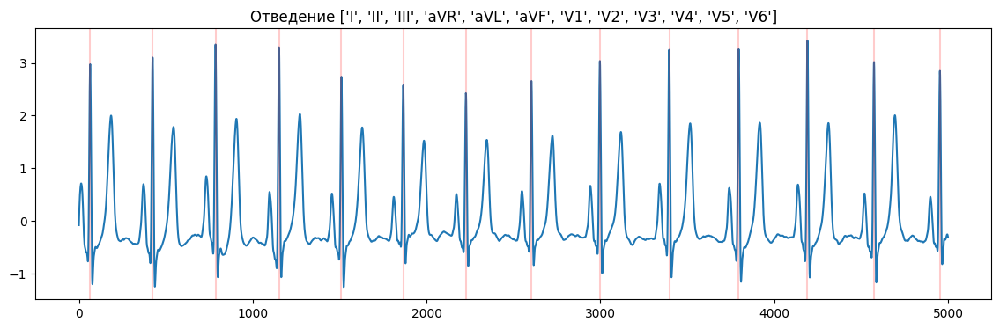

29 22 652.7857142857143 19.939832967593038 397.59693877551024


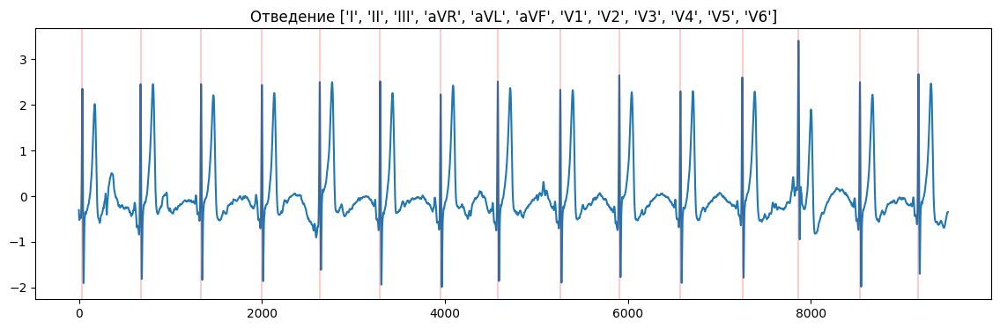

30 1 452.1111111111111 11.239260992357147 126.32098765432099


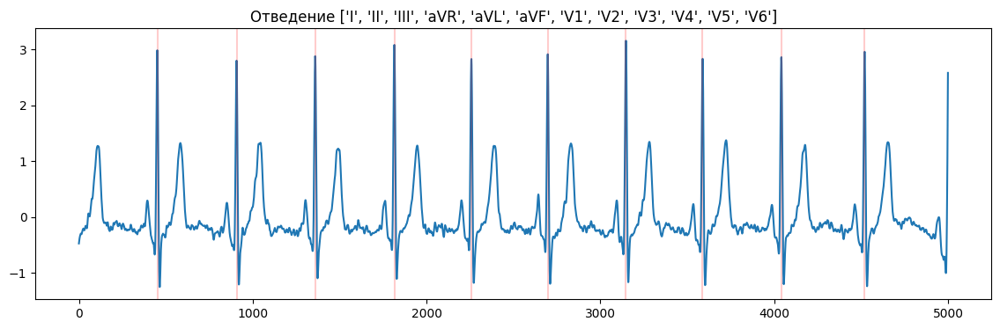

31 1 415.09090909090907 18.942278568202187 358.80991735537197


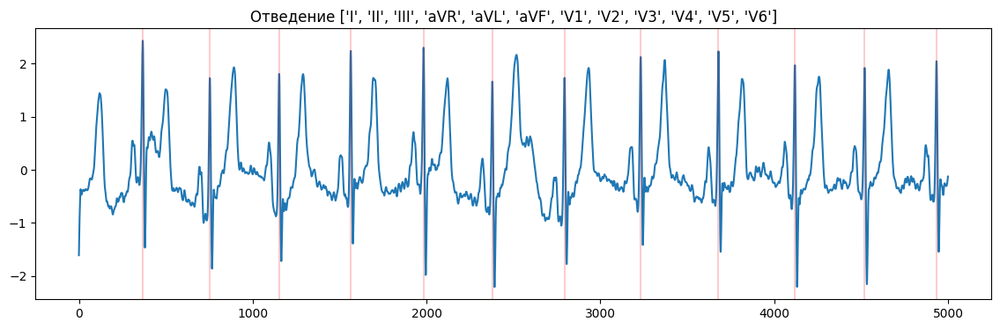

32 1 408.1818181818182 4.38630475702357 19.2396694214876


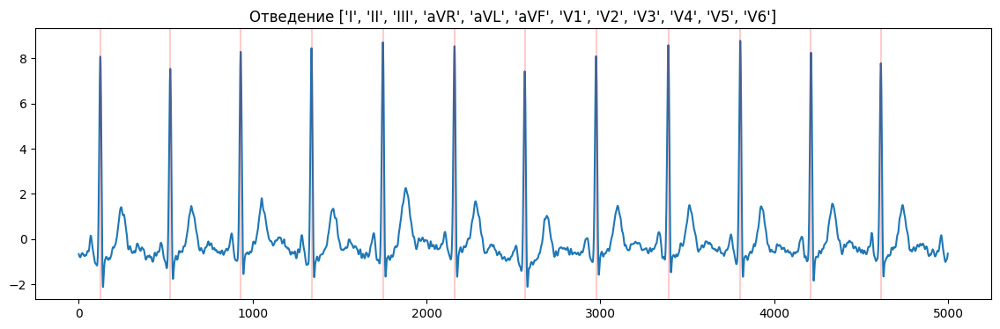

33 1 430.2 10.97087052152198 120.35999999999999


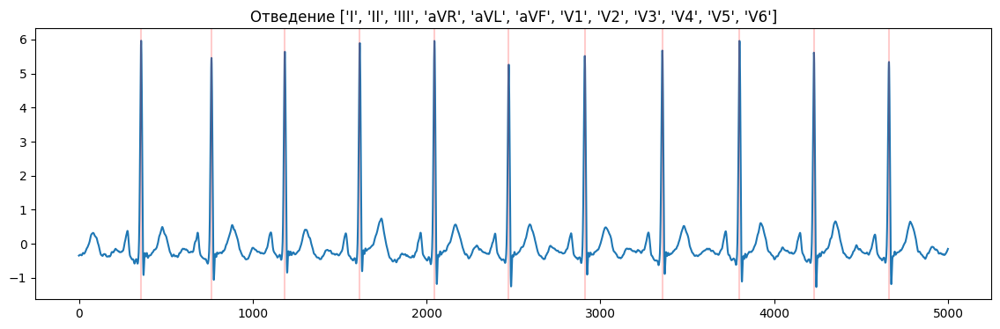

34 1 388.5833333333333 19.220034397009343 369.40972222222223


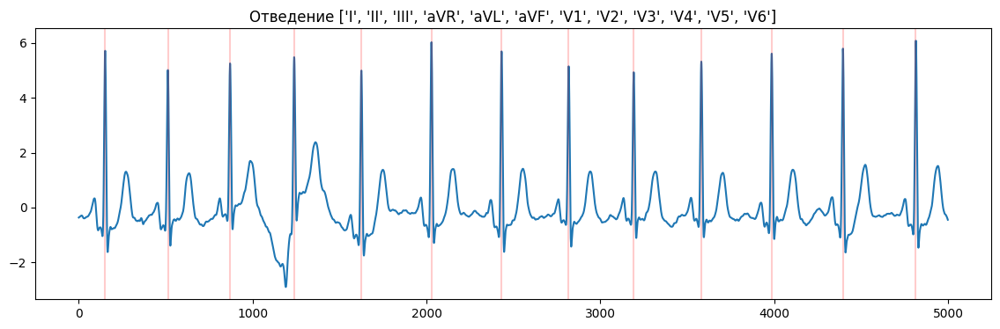

35 1 402.92857142857144 4.832394935880814 23.352040816326532


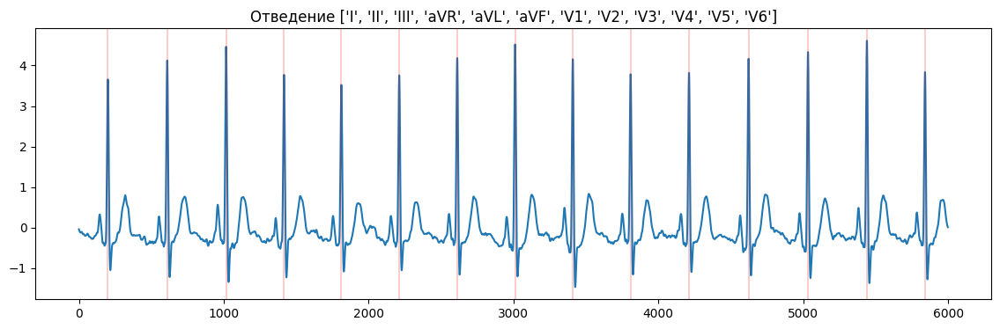

36 22;23 565.375 31.340618612273754 982.234375


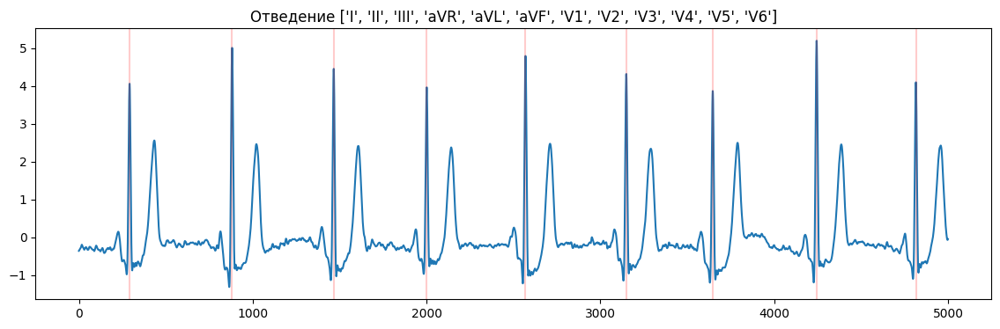

37 22 663.2857142857143 23.86697829766526 569.6326530612245


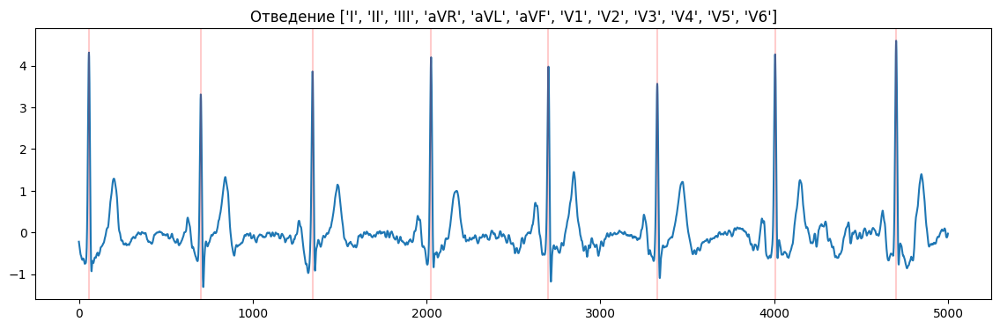

38 22;145 509.9 11.631422956801115 135.29


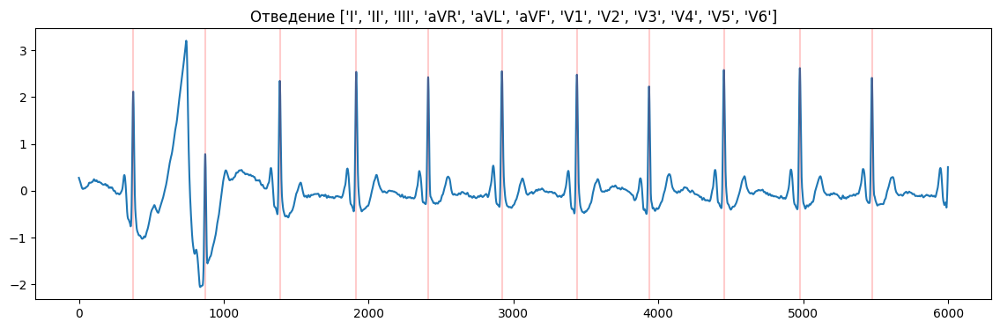

39 1 437.1 24.768730286391346 613.49


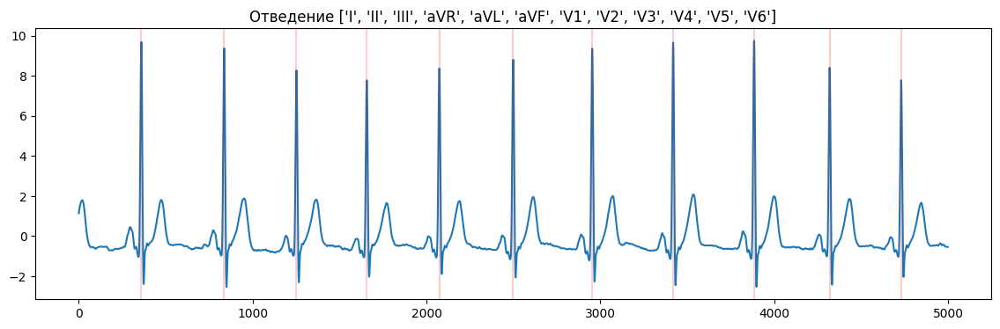

40 22;23 523.1111111111111 51.66439660484974 2669.2098765432097


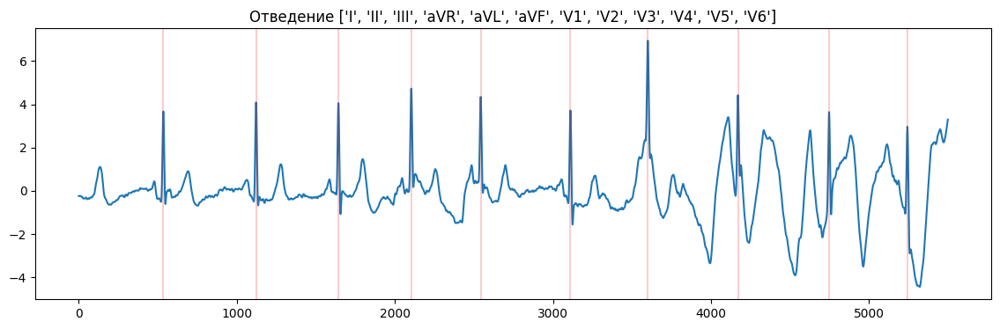

41 1 431.90909090909093 23.769554803091918 564.99173553719


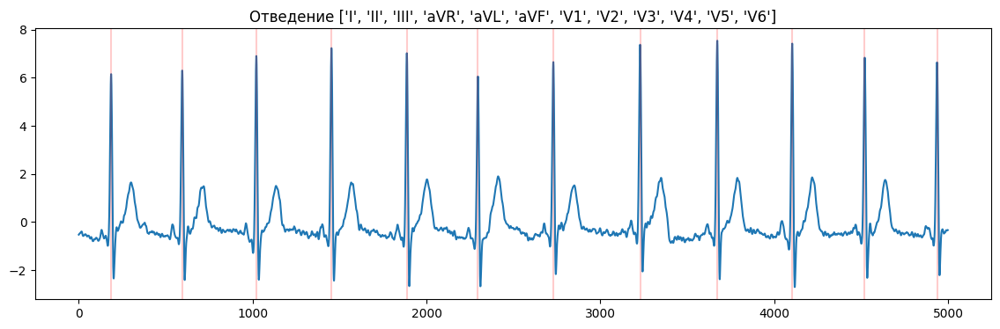

42 147 301.73333333333335 6.43393779543722 41.39555555555556


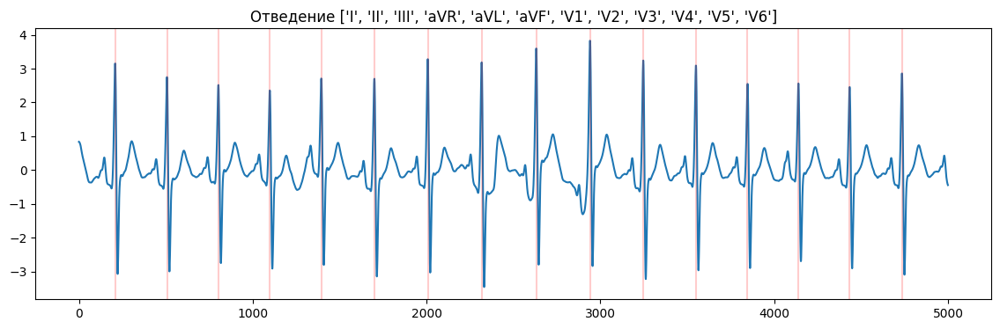

43 1 376.3333333333333 6.835365551469959 46.72222222222222


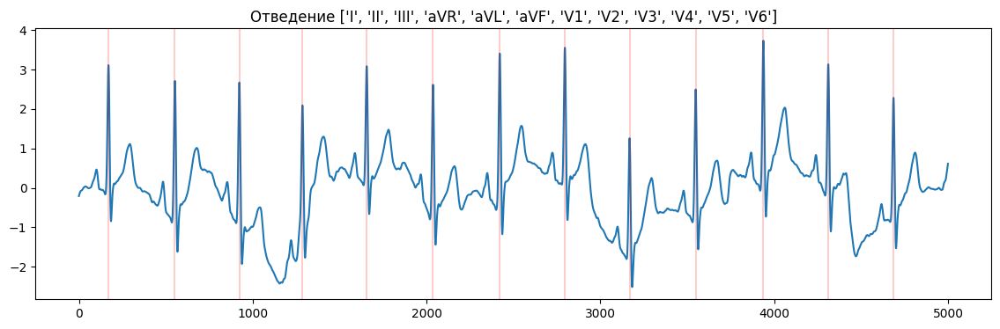

44 22 542.5 9.069178573608527 82.25


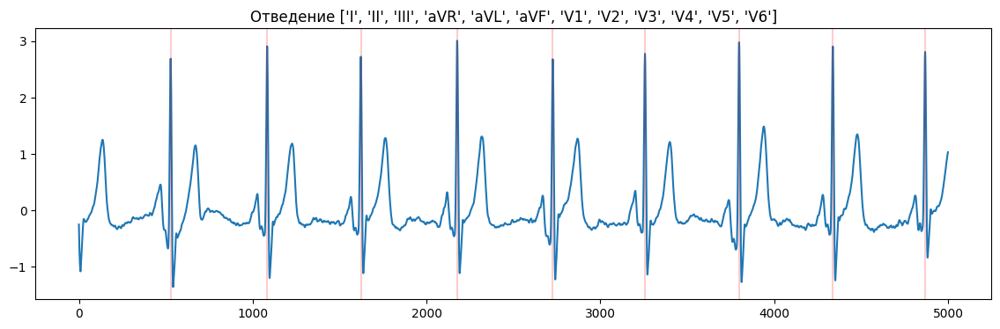

45 1 313.8 1.5577761927397231 2.426666666666667


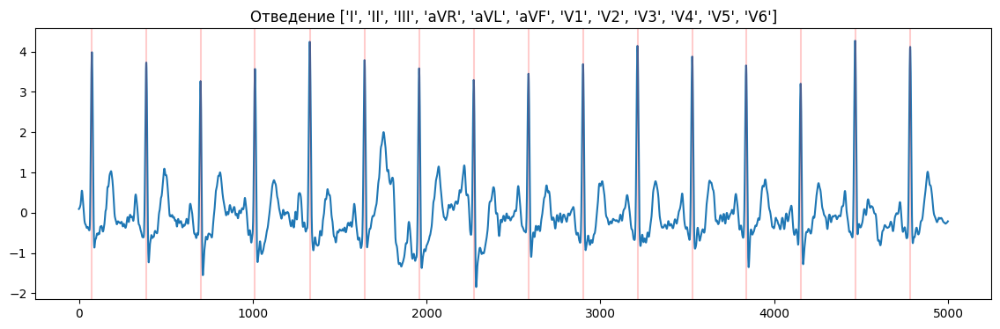

46 1 425.53846153846155 8.661278859342305 75.01775147928994


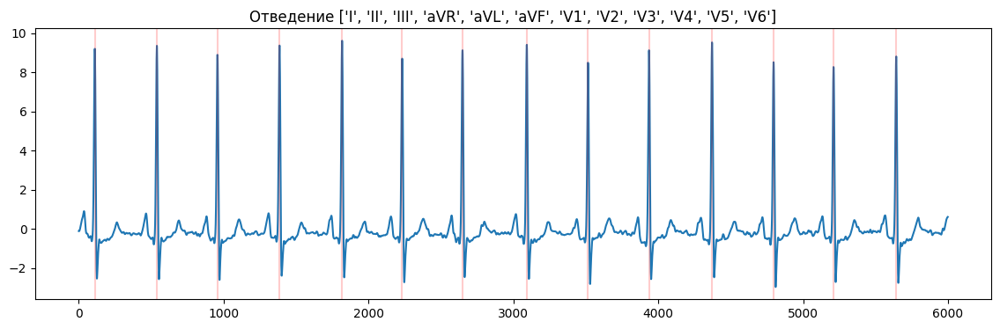

47 1 466.9 13.163965967746954 173.29


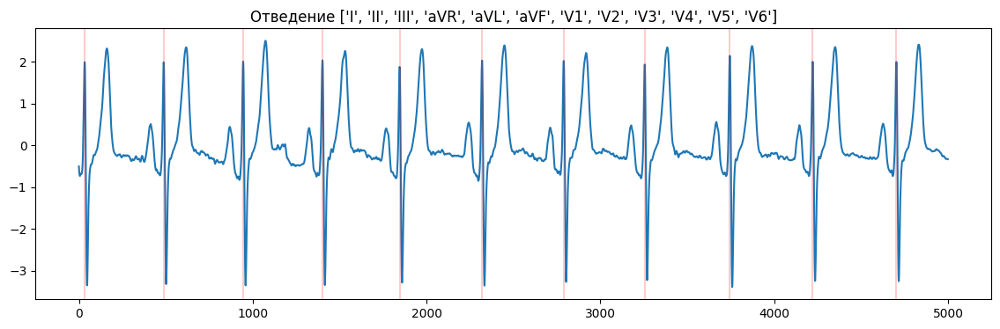

48 147 405.7857142857143 16.768075839133683 281.16836734693874


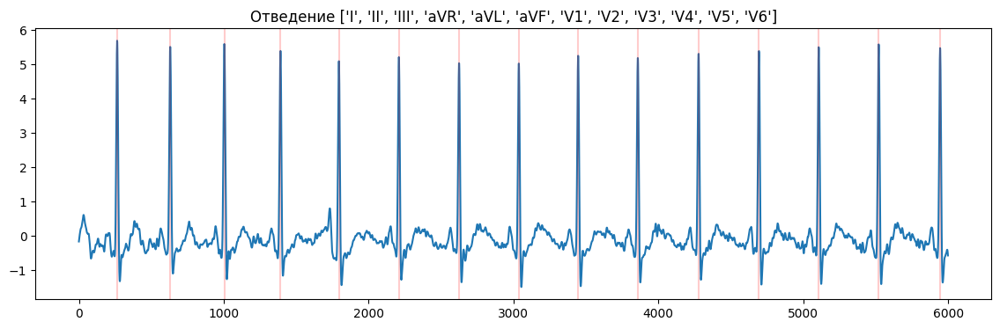

49 1 470.5 7.952986860293433 63.25


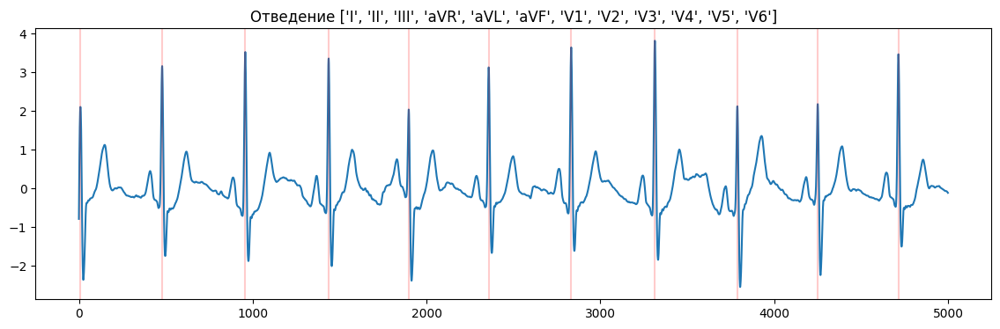

50 1 479.6666666666667 16.08311744241976 258.6666666666667


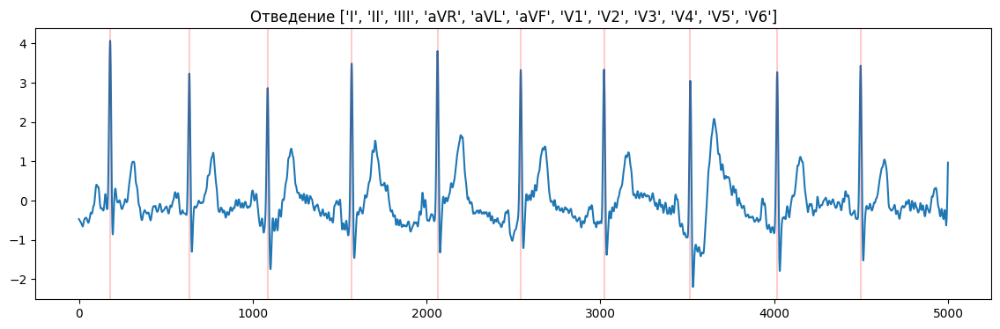

51 125 317.06666666666666 6.475252032846973 41.928888888888864


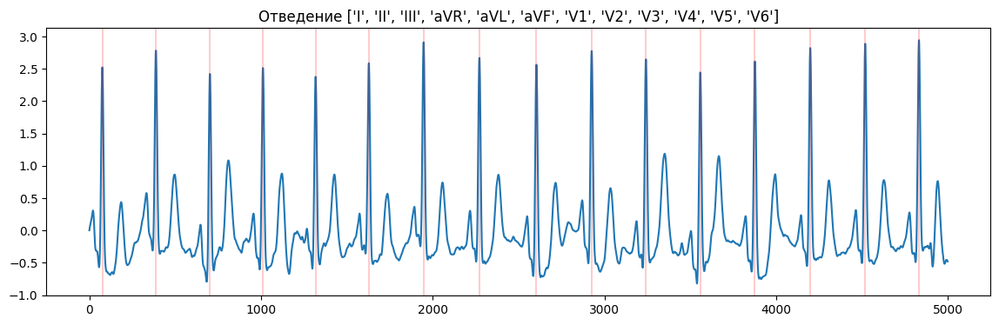

52 1 323.70588235294116 3.024696501689986 9.14878892733564


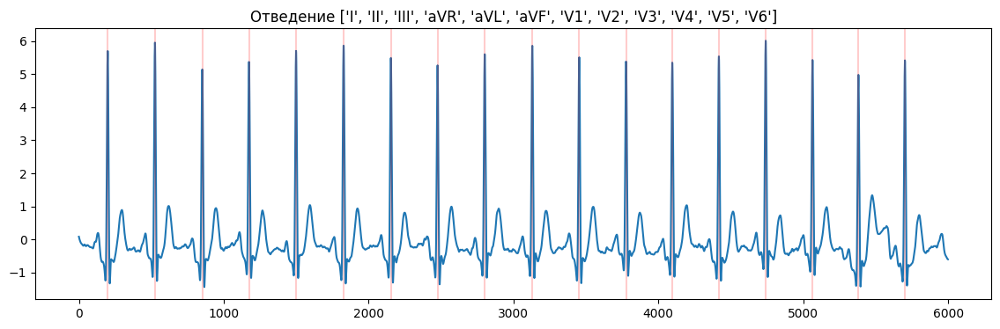

53 22 572.7142857142857 18.55273784735431 344.2040816326531


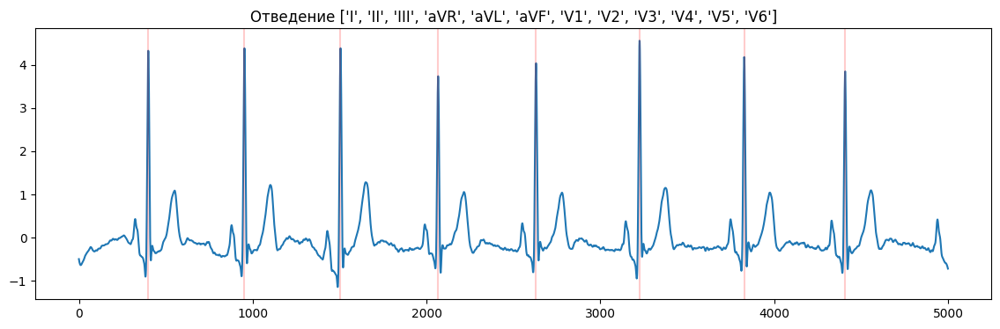

54 22;145+362 533.1111111111111 17.502028101175046 306.320987654321


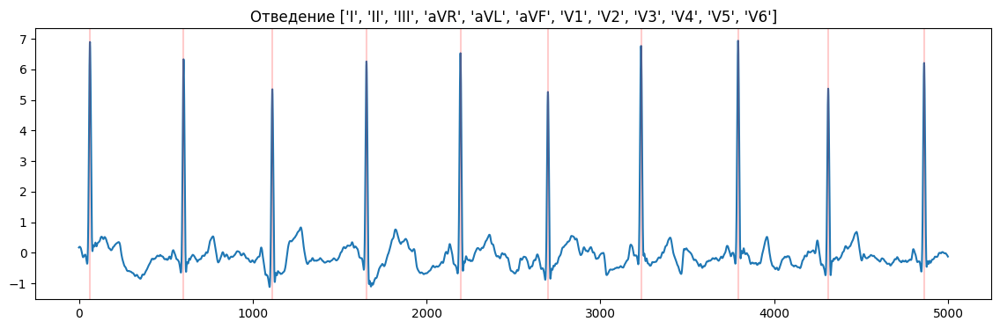

55 1 406.8181818181818 11.991043489494238 143.78512396694217


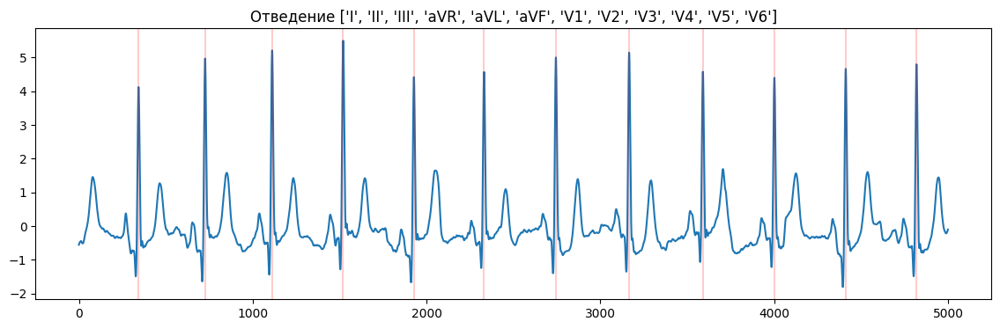

56 1 453.0833333333333 10.688454310870004 114.24305555555556


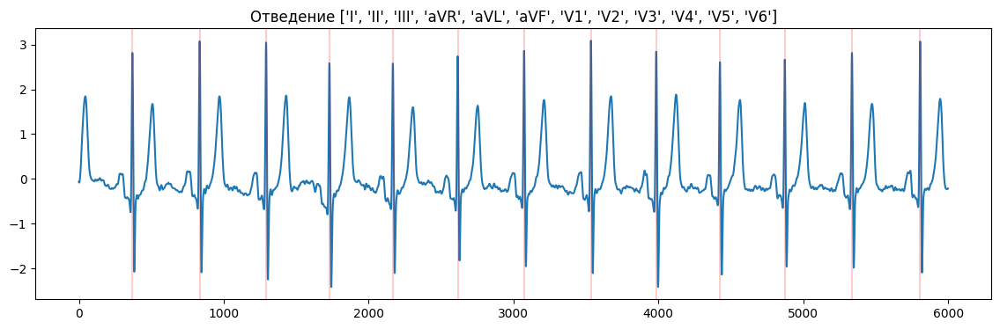

57 1 324.26666666666665 6.506065546003121 42.32888888888889


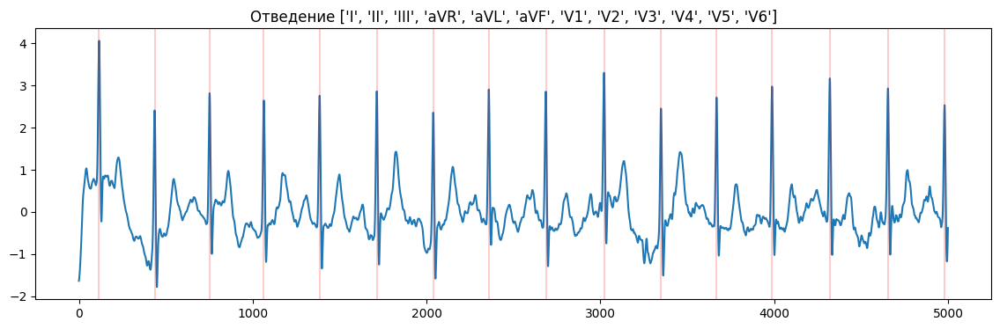

58 120 426.6363636363636 4.538175990672249 20.59504132231405


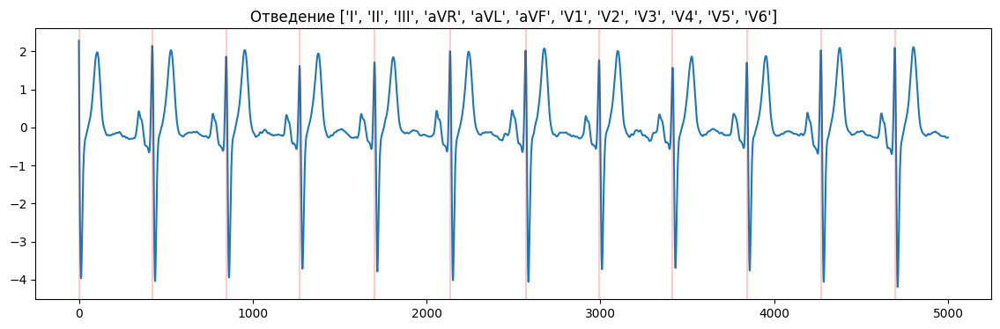

59 1 341.11764705882354 10.34625452513913 107.04498269896193


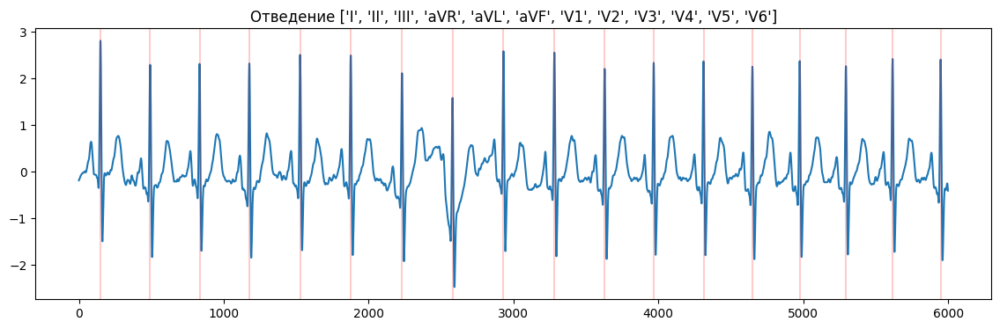

60 1 459.9 2.2113344387495983 4.890000000000001


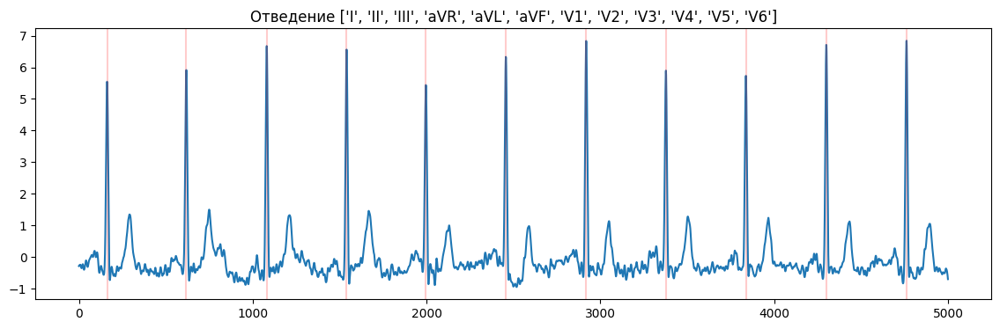

61 1 341.2857142857143 81.27416438154482 6605.489795918368


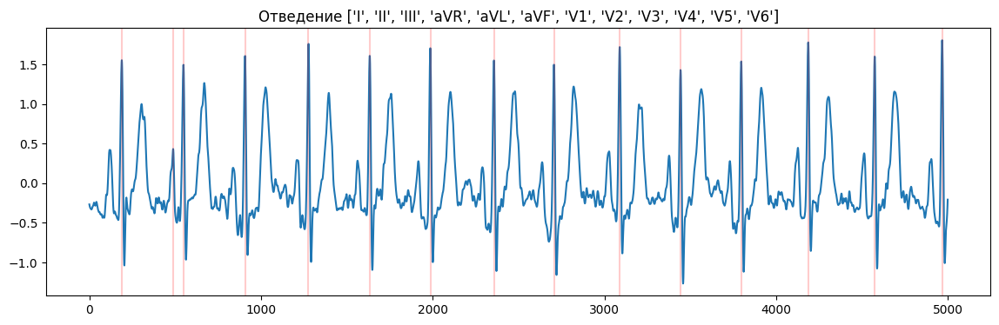

62 1 486.0 6.9602043392737 48.44444444444444


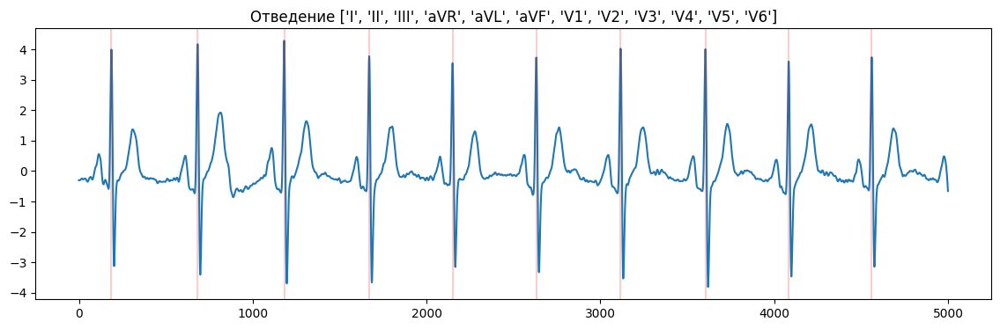

63 22 514.125 16.929541488179765 286.609375


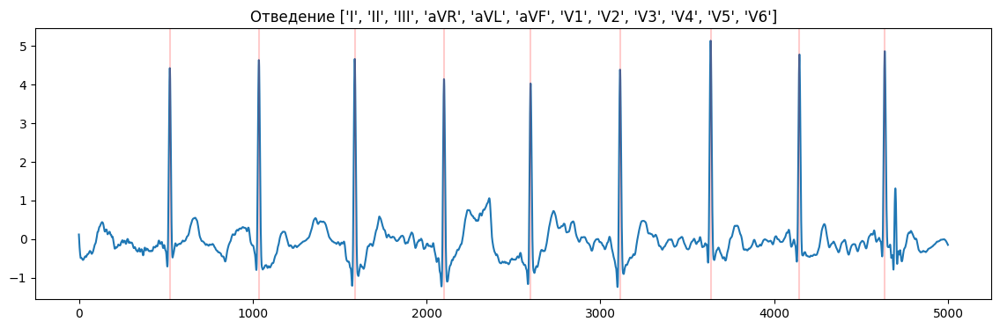

64 105 358.2307692307692 13.717780971895543 188.17751479289942


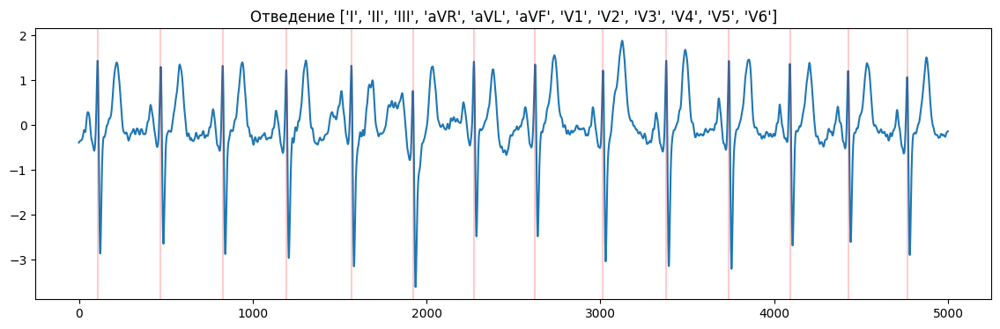

65 1 365.35714285714283 80.27595899045203 6444.229591836736


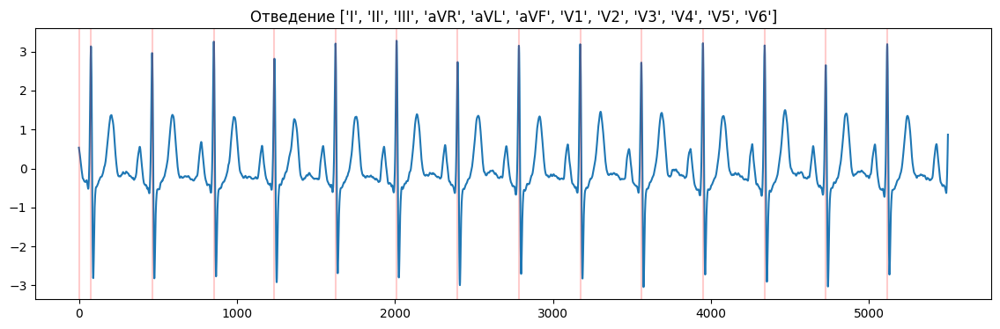

66 1 404.90909090909093 6.374017506530219 40.628099173553714


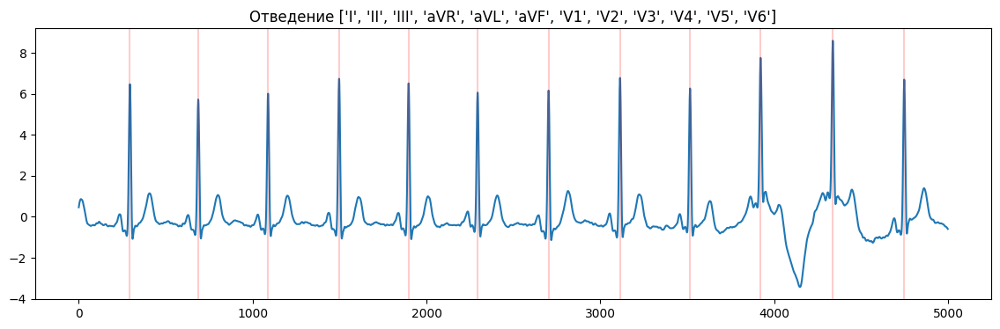

67 155 417.1818181818182 6.873112062340291 47.23966942148761


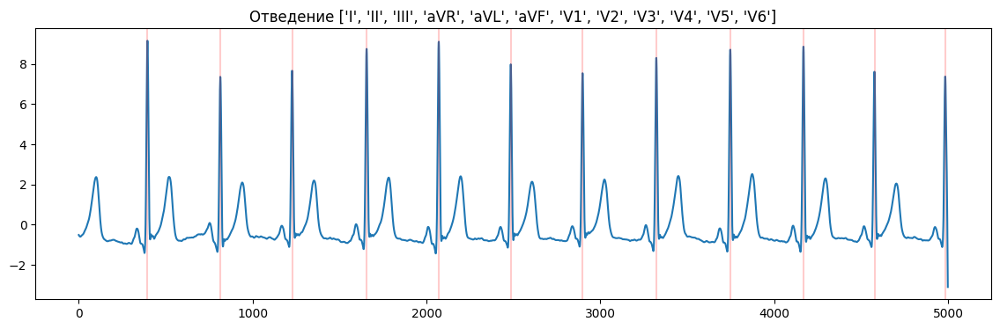

68 1 417.3636363636364 11.80348736812925 139.3223140495868


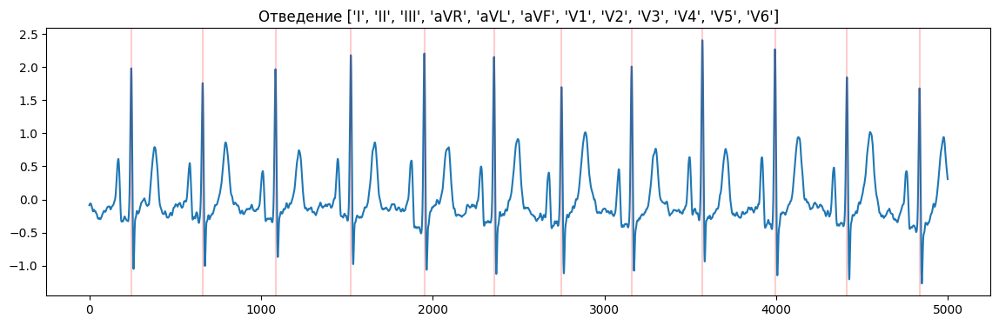

69 1 442.0 6.276941930590086 39.4


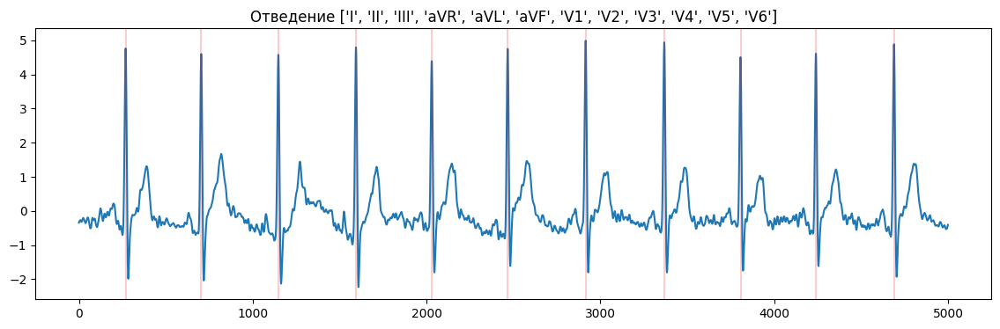

70 145+362 413.1818181818182 13.421950690215581 180.1487603305785


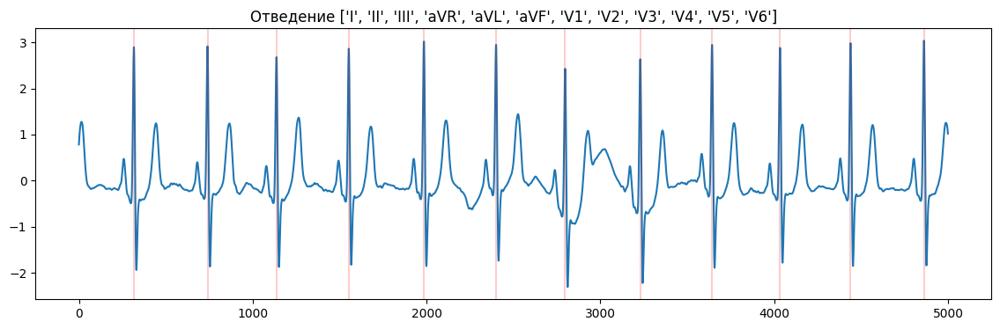

71 1 369.06666666666666 7.113055289786206 50.59555555555553


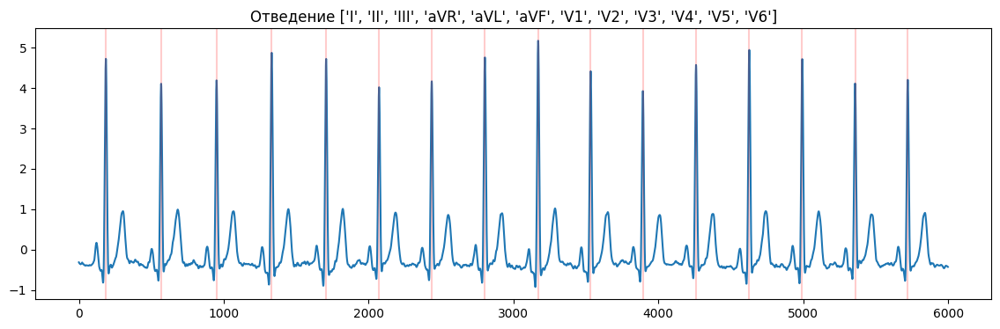

72 23 434.90909090909093 35.729932817926674 1276.6280991735537


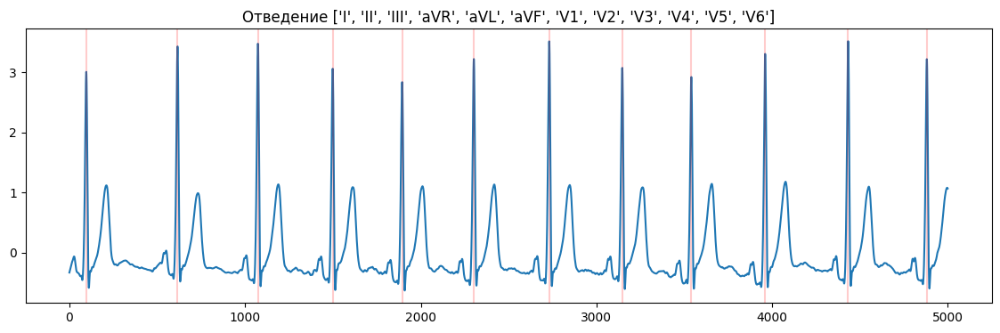

73 60+308;146 509.77777777777777 69.06804660426118 4770.3950617283945


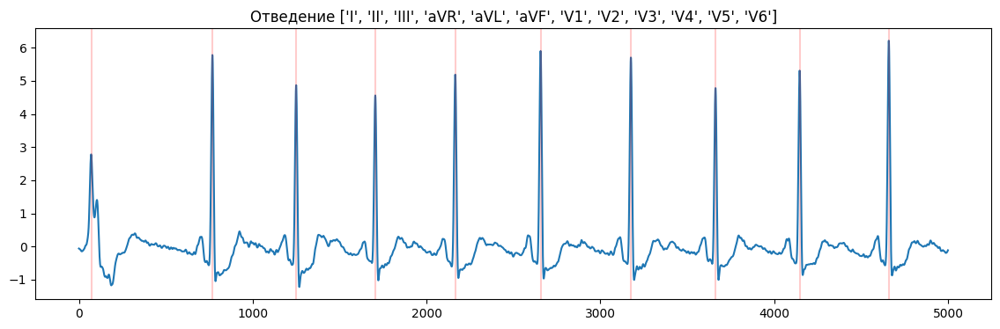

74 165+332 377.9230769230769 10.992735632516164 120.84023668639055


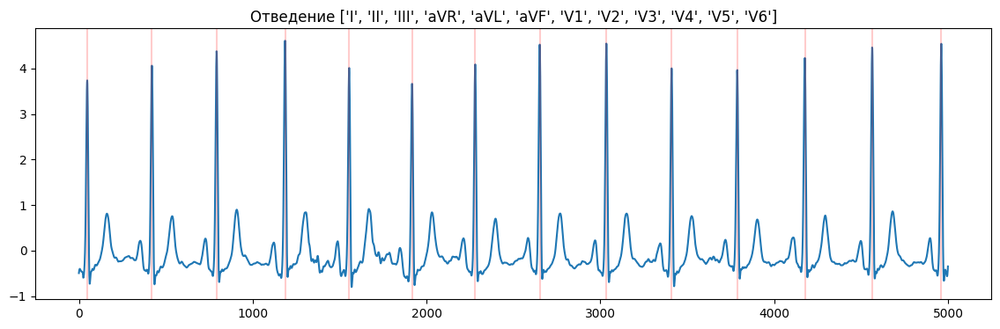

75 21;140 303.7368421052632 130.72423449676245 17088.82548476454


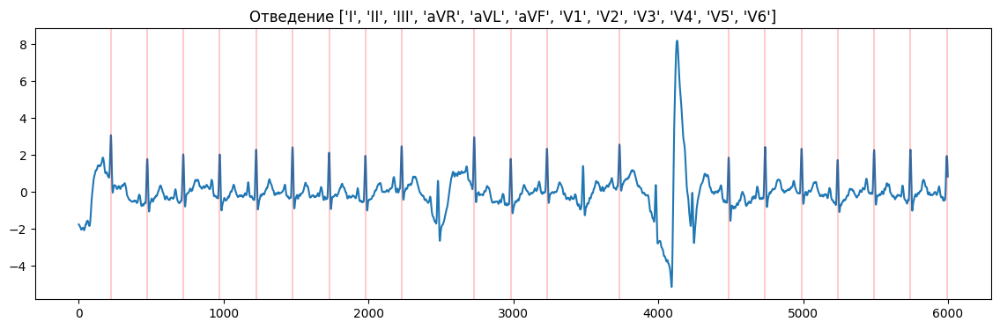

76 1 461.2 10.215674231297708 104.36000000000001


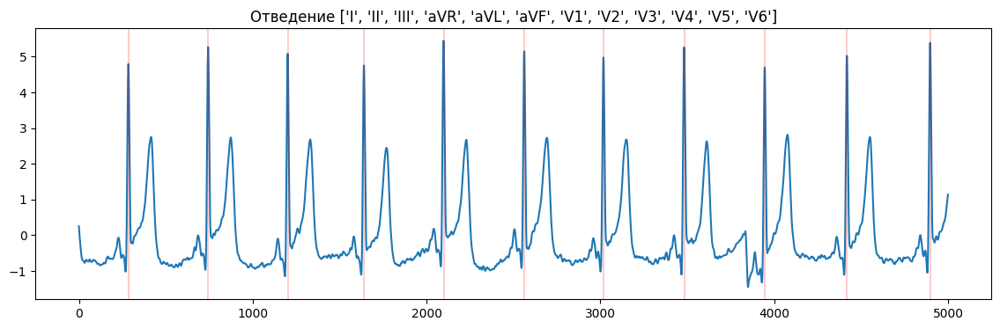

77 1 315.53333333333336 6.651983831075425 44.24888888888889


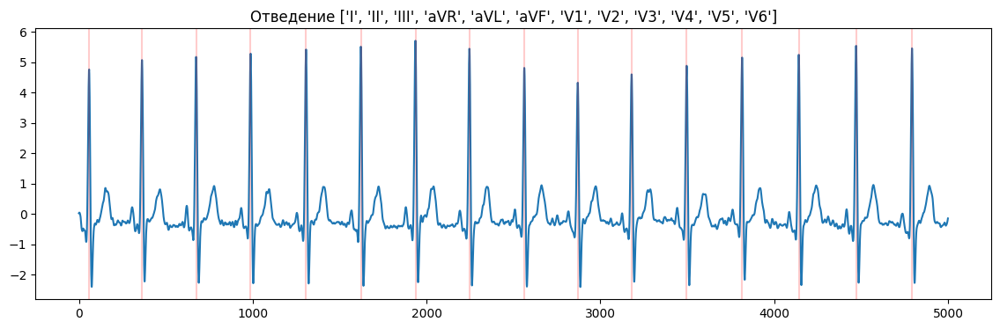

78 22 531.1 11.370576062803503 129.29


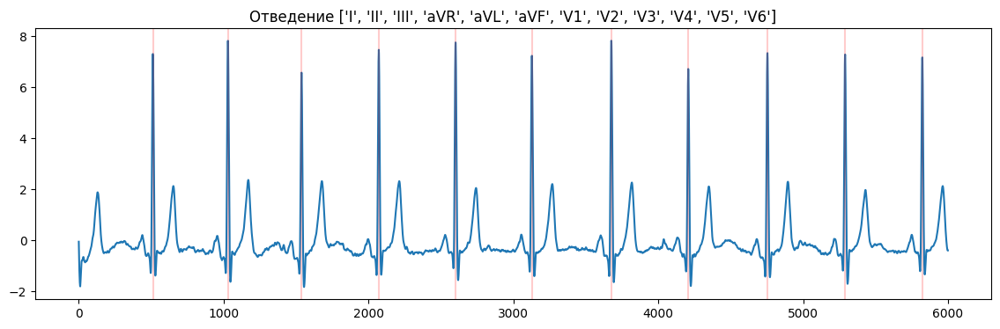

79 1 486.6363636363636 6.138888369503321 37.685950413223146


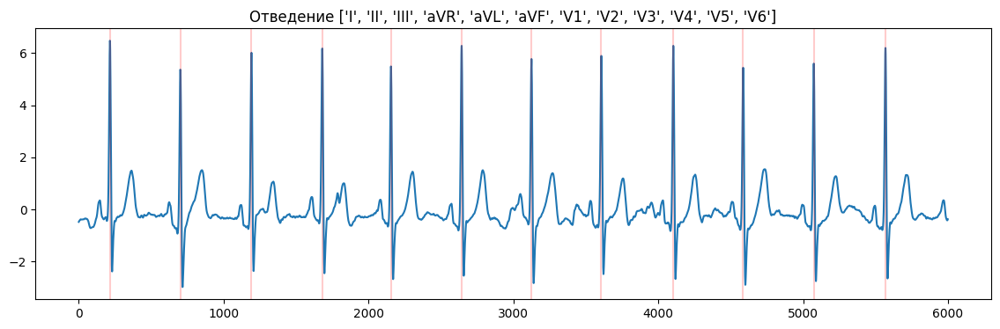

80 147 431.8181818181818 13.953286884316292 194.69421487603304


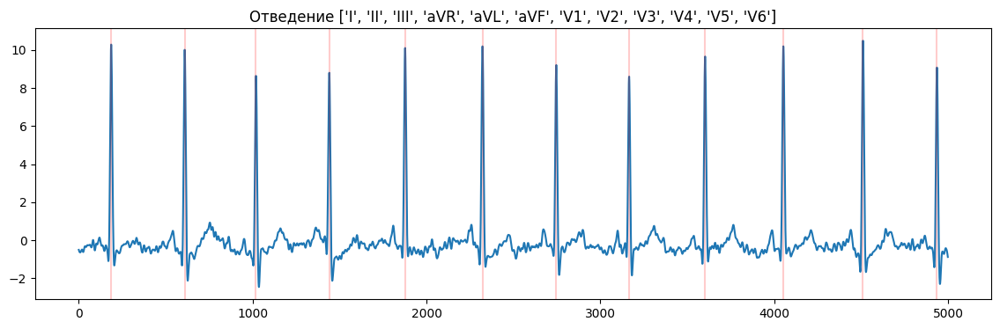

81 1 453.1 12.136309158883519 147.29


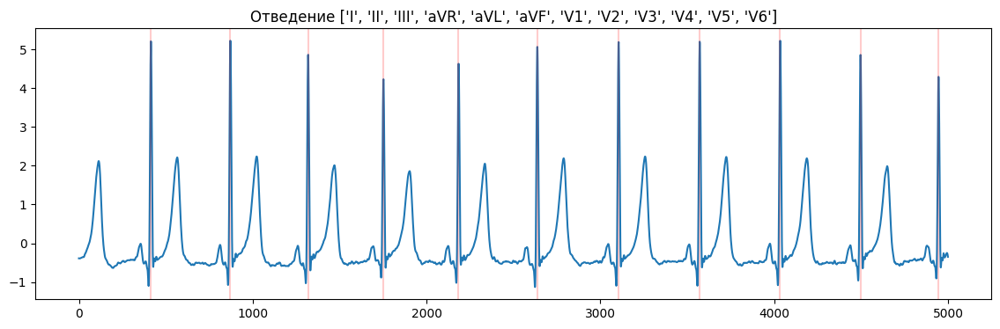

82 142;147 440.0833333333333 6.499465790013481 42.243055555555564


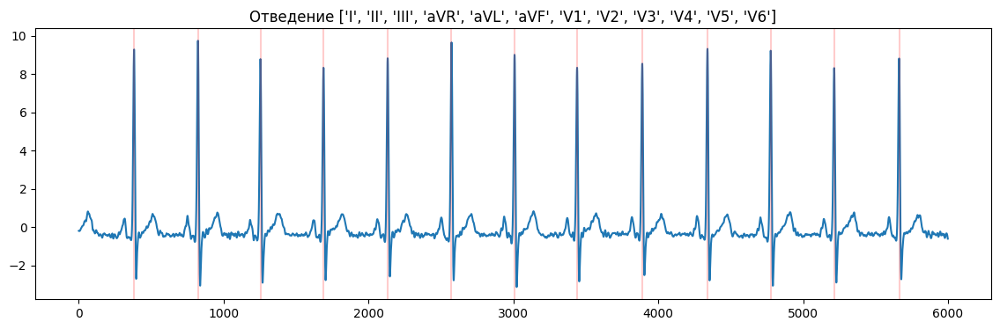

83 1 373.9230769230769 93.93406979076133 8823.60946745562


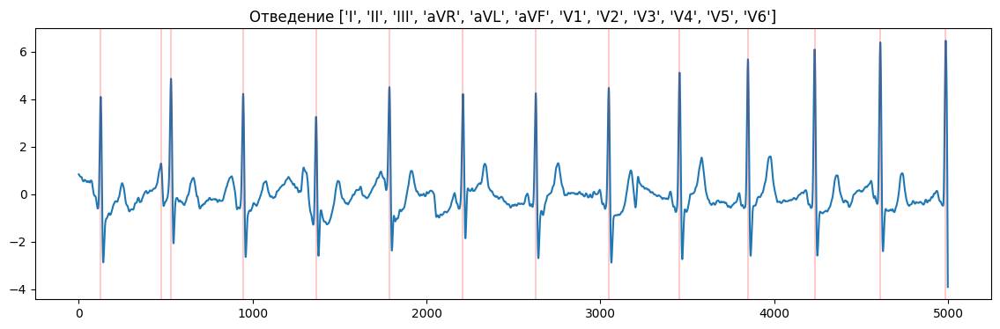

84 60 434.16129032258067 126.33113088464431 15959.554630593133


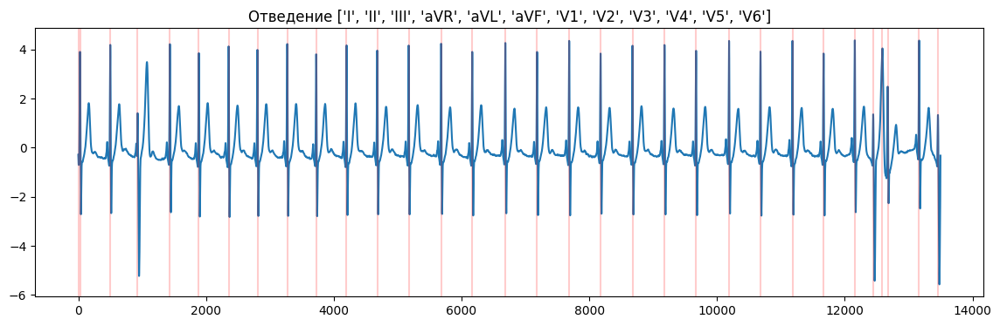

85 1 427.8 117.90487691355266 13901.560000000001


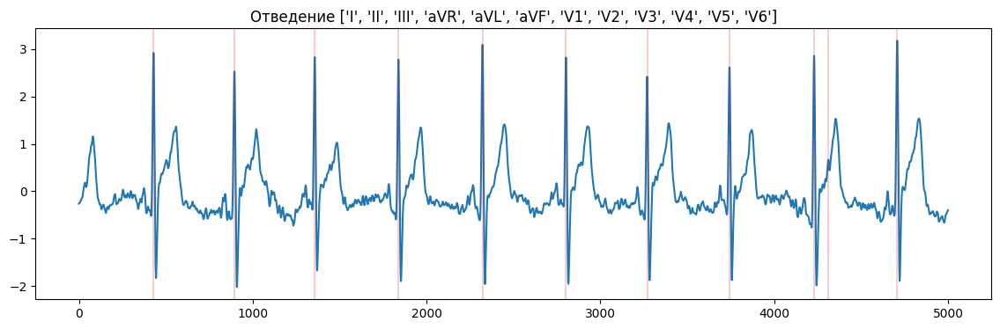

86 1 373.4166666666667 10.858624324573636 117.90972222222224


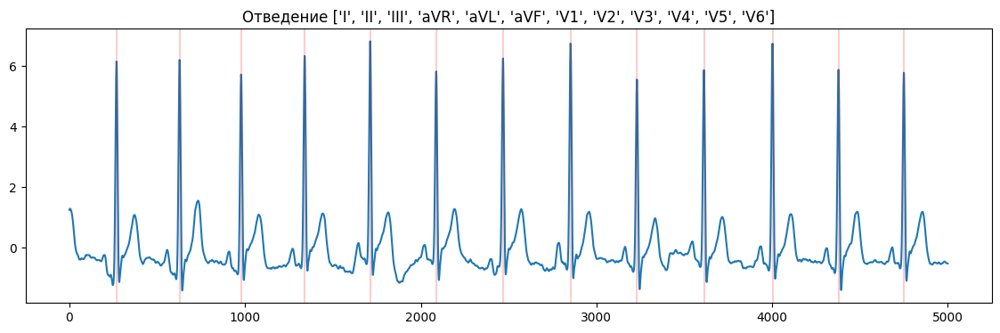

87 1 361.84615384615387 7.593987032728883 57.66863905325443


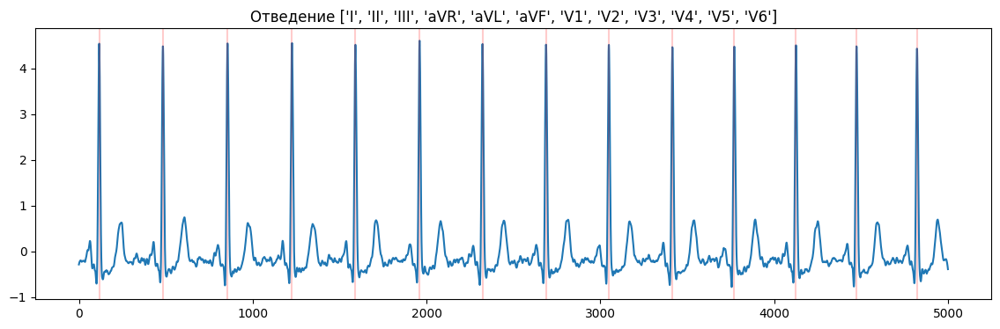

88 30+310 455.2307692307692 138.6091093943706 19212.48520710059


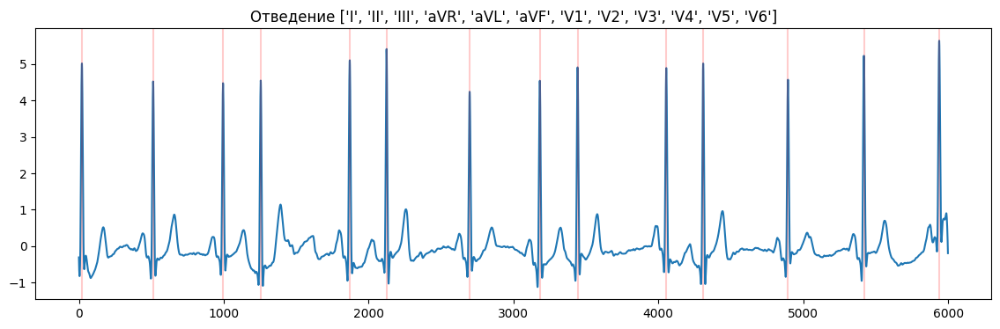

89 147 461.1666666666667 7.04548712928275 49.638888888888886


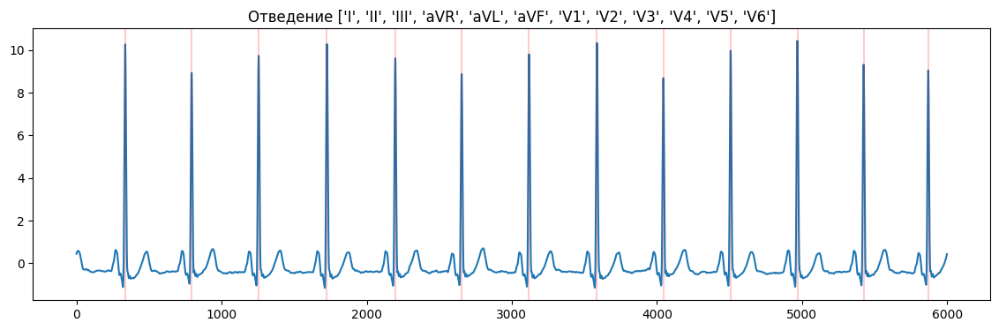

90 82;106 474.0 8.221921916437786 67.6


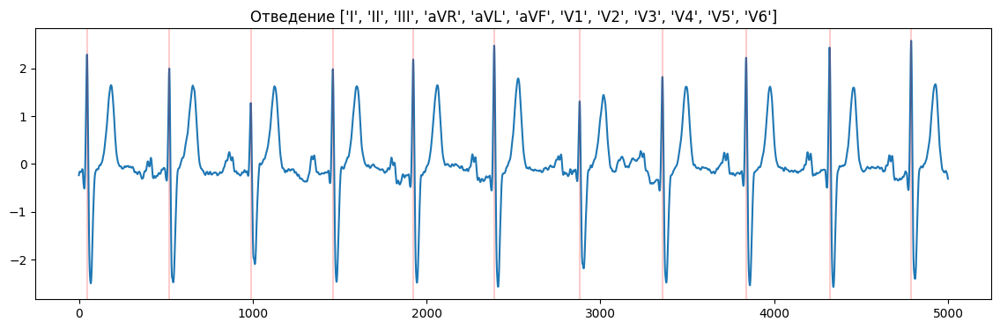

91 22;145;105 552.75 12.214233500306108 149.1875


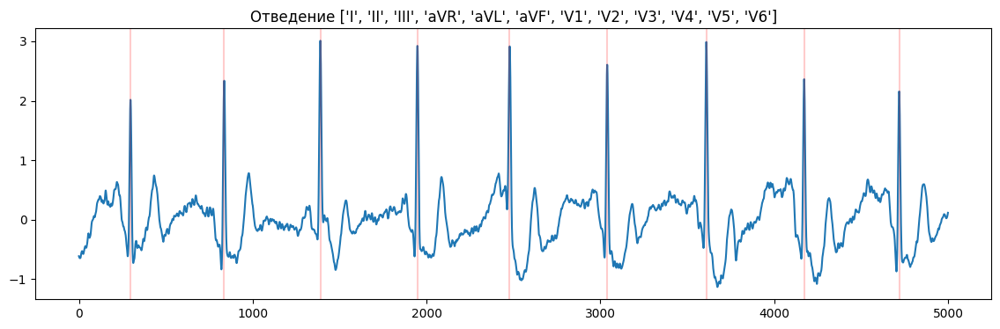

92 1 428.3636363636364 14.52441660397933 210.95867768595045


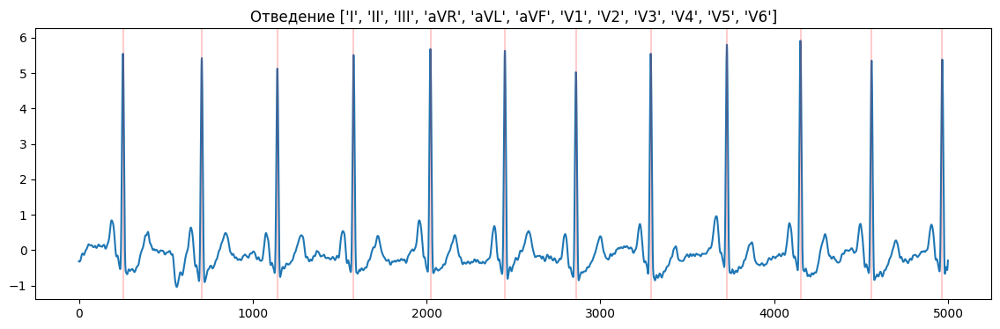

93 147+367 365.6923076923077 4.04559808993991 16.366863905325445


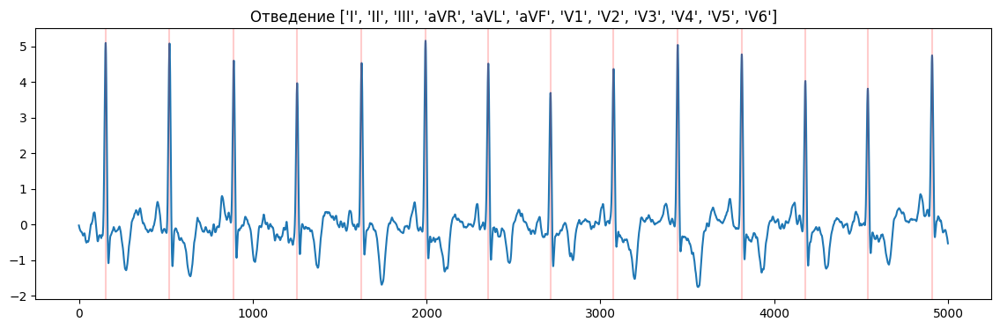

94 22 555.5 16.911534525287763 286.0


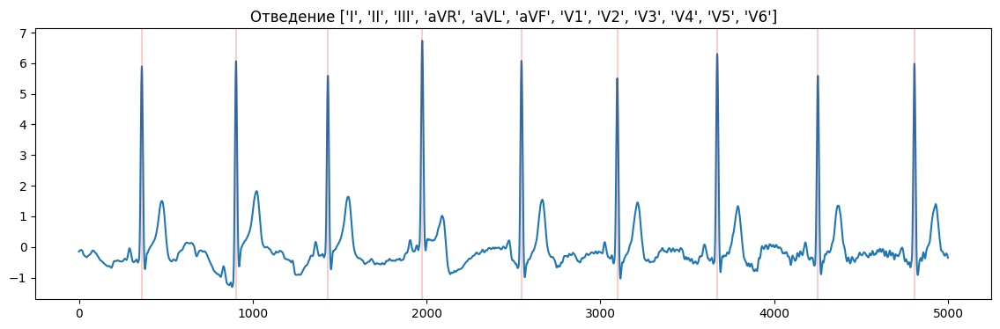

95 1 491.9 2.9137604568666933 8.49


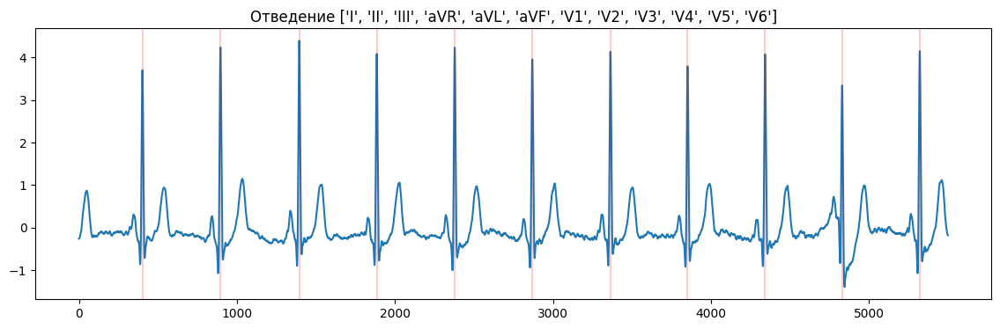

96 1 476.4 6.086049621881175 37.03999999999999


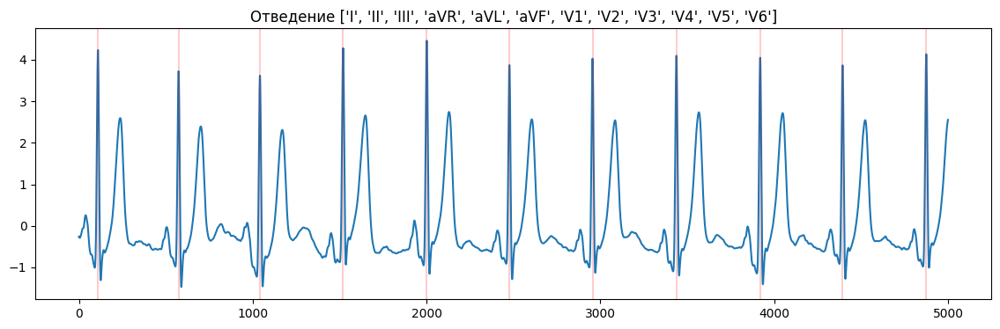

97 1 352.84615384615387 12.696735824286336 161.207100591716


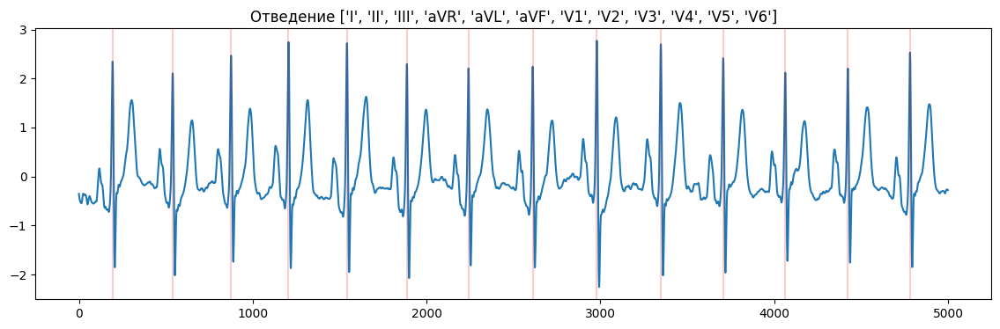

98 22 591.5714285714286 8.381222939355787 70.24489795918367


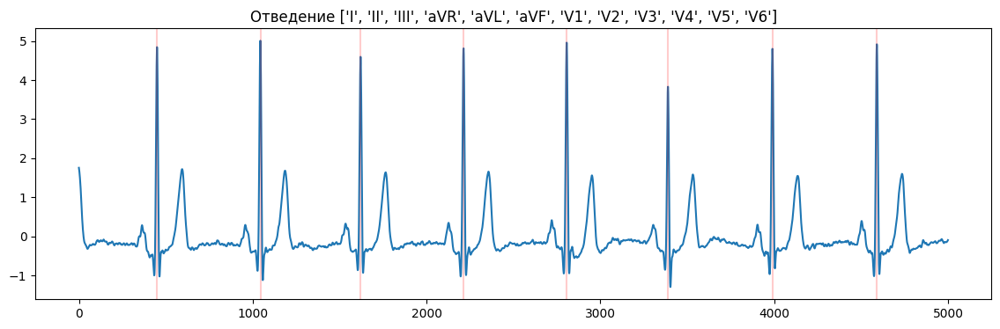

99 108 433.9 5.146843692983108 26.49


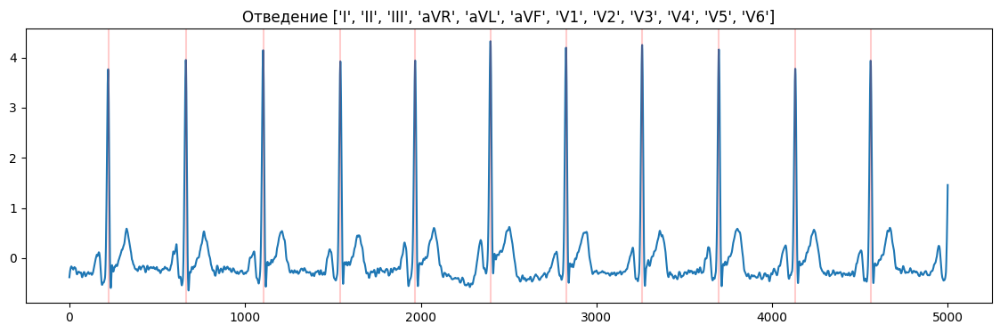

In [ ]:
f = 0
for idx, i, mean, std, var in zip(range(len(idx_code)), idx_code, means, stds, vars):
    print(idx, i, mean, std, var)
    visualize_channel_with_peaks(signals_transformed, R_peaks=r_peaks_all, index=idx)
    f = f + 1
    if f  >= 100:
        break

In [ ]:
class SimpleModel(nn.Module):
    def __init__(self, num_classes):
        """Регистрация блоков"""
        super().__init__()
        self.lin1 = nn.Linear(2, 4)  # Полносвязный слой 1
        self.lin2 = nn.Linear(4, 8)   # Полносвязный слой 2
        self.lin3 = nn.Linear(8, num_classes)    # Полносвязный слой 3
        self.relu = nn.ReLU()           # Функция активации 1
        self.tanh = nn.Tanh()           # Функция активации 2
        self.soft = nn.Softmax(dim=1)   # Функция активации 3
        
    def forward(self, x):
        """Прямой проход"""
        h = self.lin1(x)
        h = self.relu(h)
        # h = self.lin3(h)
        
        h = self.lin2(h)
        h = self.tanh(h)
        h = self.lin3(h)
        y = self.soft(h)
        return y

def train_simple_arythmia(means, stds, y):    
    sk = StandardScaler()
    # means = sk.fit_transform([means])
    # stds = sk.fit_transform([stds])
    X = []
    for i in range(len(stds)):
        if not(np.isnan(means[i]) or np.isnan(stds[i])):
            X.append([means[i], stds[i]])
        # X = [[means[i], stds[i]] for i in range(len(stds))]
    
    meanX = np.mean(X, axis=0)
    stdX = np.std(X, axis=0)
    X = (X - meanX) / (stdX + 1e-8)

    class_counts = torch.tensor(np.bincount(y.flatten()).tolist())
    class_weights = 1. / class_counts.float()
    class_weights = class_weights / class_weights.sum() * len(class_counts)
    
    criterion = nn.CrossEntropyLoss(weight=class_weights)

    unique_y = len(np.unique(y))

    model = SimpleModel(unique_y)
    model.train()

    # criterion = nn.CrossEntropyLoss()  # Включает LogSoftmax + NLLLoss
    optimizer = optim.Adam(model.parameters(), lr=1e-3)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=5)

    epochs = 20
    for epoch in range(epochs):
        # Forward pass
        train_loss = 0
        for i in range(len(X)):
            y_ = [0 for k in range(unique_y)]
            y_[int(y[i][0])] = 1

            outputs = model(torch.tensor([X[i]], dtype=torch.float32))
            
            loss = criterion(outputs, torch.tensor([y_], dtype=torch.float32))
            
            # Backward pass
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
            
            # Логирование
        # if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {train_loss/len(y):.4f}')
    
    model.eval()
    return model

In [ ]:
class SimpleModel(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.lin1 = nn.Linear(2, 4)
        self.lin2 = nn.Linear(4, 8)
        self.lin3 = nn.Linear(8, num_classes)
        self.relu = nn.ReLU()
        
        # Инициализация весов для стабильности
        for layer in [self.lin1, self.lin2, self.lin3]:
            nn.init.xavier_normal_(layer.weight)
            nn.init.zeros_(layer.bias)

    def forward(self, x):
        h = self.relu(self.lin1(x))
        h = self.relu(self.lin2(h))  # Заменили tanh на relu
        h = self.lin3(h)  # Не используем softmax здесь!
        return h

def train_simple_arythmia(means, stds, y):
    # Преобразование данных в тензоры
    X = torch.tensor(np.column_stack([means, stds]), dtype=torch.float32)
    y = torch.tensor(y, dtype=torch.long).squeeze()  # Метки как индексы классов

    # Нормализация данных
    X = (X - X.mean(dim=0)) / (X.std(dim=0) + 1e-8)

    unique_y = len(torch.unique(y))
    model = SimpleModel(unique_y)
    
    # Настройка оптимизатора и функции потерь
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001)  # Уменьшили learning rate
    
    # Обучение с батчами
    batch_size = 32
    epochs = 10
    
    for epoch in range(epochs):
        permutation = torch.randperm(X.size(0))
        total_loss = 0
        
        for i in range(0, X.size(0), batch_size):
            indices = permutation[i:i+batch_size]
            batch_X = X[indices]
            batch_y = y[indices]
            
            outputs = model(batch_X)
            loss = criterion(outputs, batch_y)
            
            optimizer.zero_grad()
            loss.backward()
            
            # Клиппинг градиентов для предотвращения взрыва
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            
            optimizer.step()
            total_loss += loss.item()
        
        avg_loss = total_loss / (X.size(0) // batch_size)
        print(f'Epoch [{epoch+1}/{epochs}], Loss: {avg_loss:.4f}')

In [204]:
k = len(means)
meansK = means[0:k]
stdsK = stds[0:k]
varsK = vars[0:k]
yK = labels_transformed[0:k]
y_ar_K = labels_transformed_arythmia[0:k]

In [178]:
mod1 = train_simple_arythmia(meansK, stdsK, y_ar_K)

Epoch [1/20], Loss: 0.5796
Epoch [2/20], Loss: 0.5759
Epoch [3/20], Loss: 0.5736
Epoch [4/20], Loss: 0.5722
Epoch [5/20], Loss: 0.5715
Epoch [6/20], Loss: 0.5708
Epoch [7/20], Loss: 0.5701
Epoch [8/20], Loss: 0.5695
Epoch [9/20], Loss: 0.5687
Epoch [10/20], Loss: 0.5679
Epoch [11/20], Loss: 0.5673
Epoch [12/20], Loss: 0.5667
Epoch [13/20], Loss: 0.5663
Epoch [14/20], Loss: 0.5660
Epoch [15/20], Loss: 0.5656
Epoch [16/20], Loss: 0.5654
Epoch [17/20], Loss: 0.5651
Epoch [18/20], Loss: 0.5647
Epoch [19/20], Loss: 0.5643
Epoch [20/20], Loss: 0.5638


In [179]:
X = [[meansK[i], stdsK[i]] for i in range(len(stdsK))]

In [181]:
cl = [0,0]
i = 0

good_0 = 0
bad_0 = 0
good_1 = 0
bad_1 = 0

for x in X:
    with torch.no_grad():
        logits = mod1(torch.tensor([x], dtype=torch.float32))
        probabilities = torch.softmax(logits, dim=1)  # Получаем вероятности
        predicted_classes = torch.argmax(probabilities, dim=1)
        cl[predicted_classes] = cl[predicted_classes] + 1

        if predicted_classes == y_ar_K[i]:
            if predicted_classes == 0:
                good_0 = good_0 + 1
            else:
                good_1 = good_1 + 1
        else:
            if predicted_classes == 0:
                bad_1 = bad_1 + 1
            else:
                bad_0 = bad_0 + 1

    # print("Predicted classes:", predicted_classes)
    i = i + 1
print(cl)
print(good_0, bad_0)
print(bad_1, good_1)

[3, 1494]
2 1050
1 444


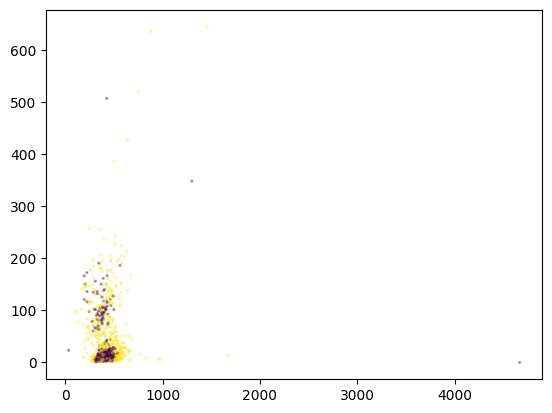

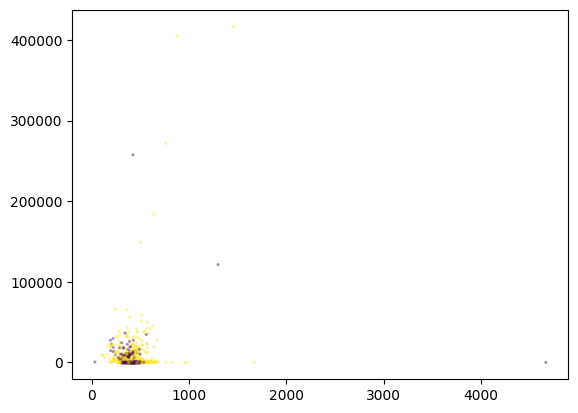

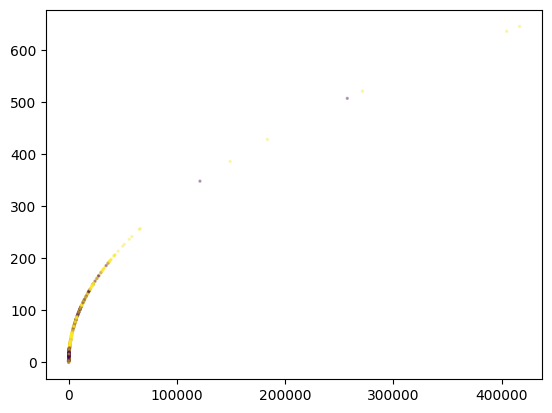

In [170]:
plt.scatter(meansK, stdsK, c=yK, alpha=0.3, s=2)
plt.show()
plt.scatter(meansK, varsK, c=yK, alpha=0.3, s=2)
plt.show()
plt.scatter(varsK, stdsK, c=yK, alpha=0.3, s=2)
plt.show()

In [171]:
labels_transformed_arythmia = label_transform_arythmia_tensor(labels, categories=False)
y_ar_K = labels_transformed_arythmia[0:k]

colors = [[0,0,0], [0.2,0.7,0.2], [0.7,0.2,0.2], [0.2,0.0,0.7], [0.9,0.0,0.2], [0.0,0.9,0.0]]
y_ar_K_colors = []

for y_ar in y_ar_K:
    y_ar_K_colors.append(colors[int(y_ar[0])])

Label transformed to tensor successfully



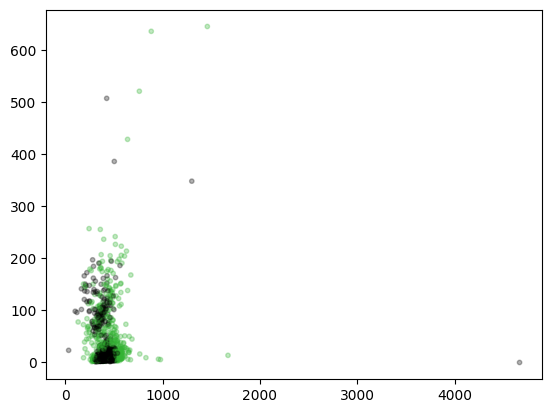

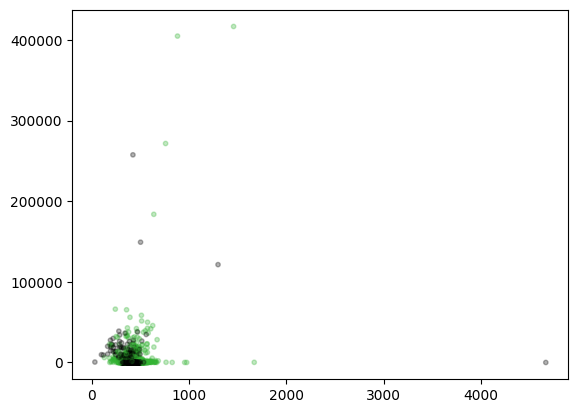

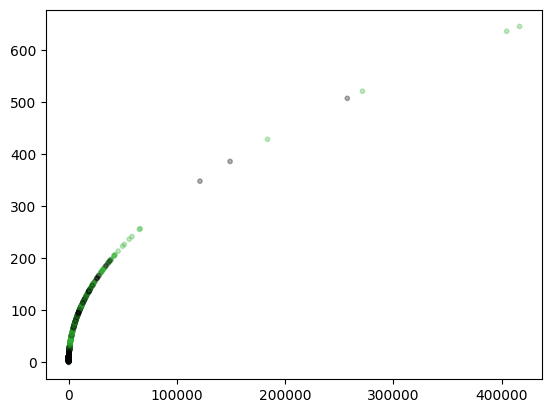

In [172]:
plt.scatter(meansK, stdsK, c=y_ar_K_colors, alpha=0.3, s=10)
plt.show()
plt.scatter(meansK, varsK, c=y_ar_K_colors, alpha=0.3, s=10)
plt.show()
plt.scatter(varsK, stdsK, c=y_ar_K_colors, alpha=0.3, s=10)
plt.show()

Accuracy: 0.81
F1-score: 0.81
Confusion Matrix:
[[906 144]
 [144 300]]


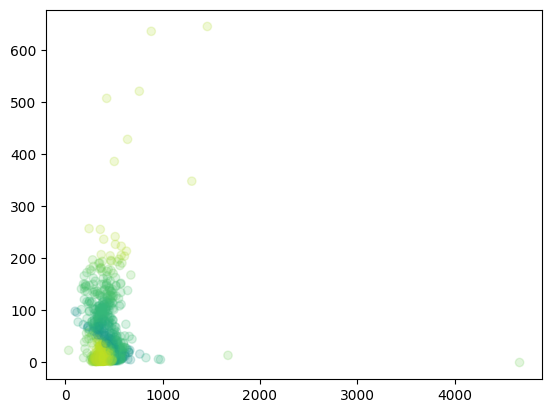

Accuracy: 0.83
F1-score: 0.82
Confusion Matrix:
[[982  68]
 [193 251]]


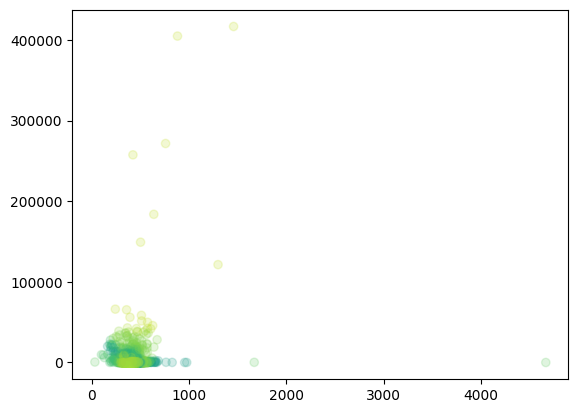

Accuracy: 0.76
F1-score: 0.76
Confusion Matrix:
[[895 155]
 [203 241]]


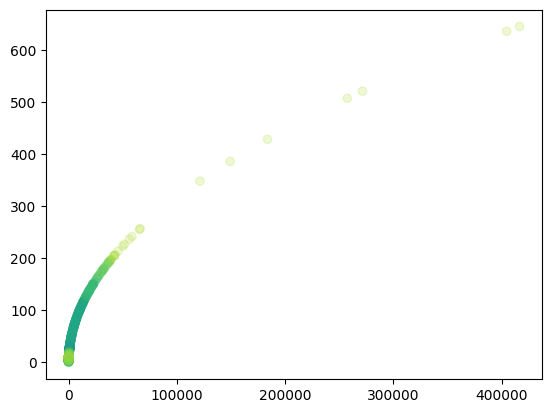

In [173]:
bayes(meansK, stdsK, torch.tensor([[int(i[0])] for i in y_ar_K]))
bayes(meansK, varsK, torch.tensor([[int(i[0])] for i in y_ar_K]))
bayes(varsK, stdsK, torch.tensor([[int(i[0])] for i in y_ar_K]))

In [174]:
labels_transformed_arythmia = label_transform_arythmia_tensor(labels, categories=True)
y_ar_K = labels_transformed_arythmia[0:k]

colors = [[0,0,0], [0.2,0.7,0.2], [0.7,0.2,0.2], [0.2,0.0,0.7], [0.9,0.0,0.2], [0.0,0.9,0.0]]
y_ar_K_colors = []

for y_ar in y_ar_K:
    y_ar_K_colors.append(colors[int(y_ar[0])])

Label transformed to tensor successfully



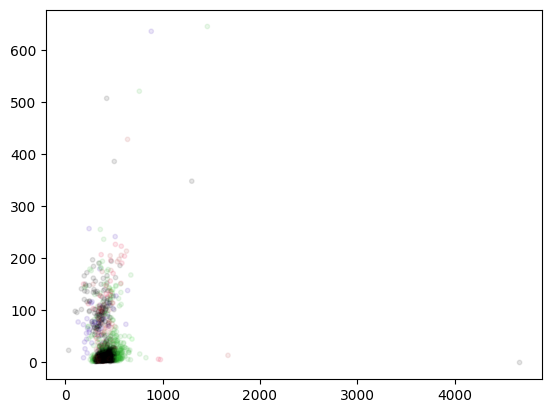

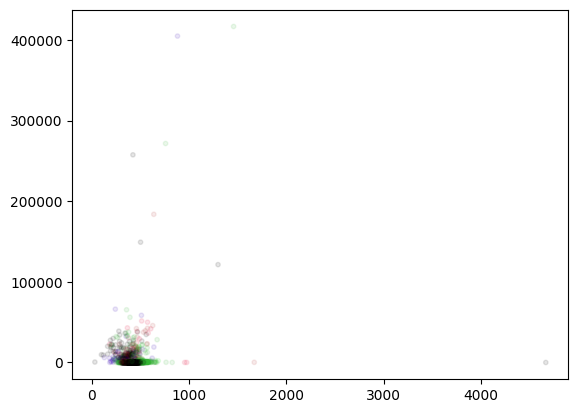

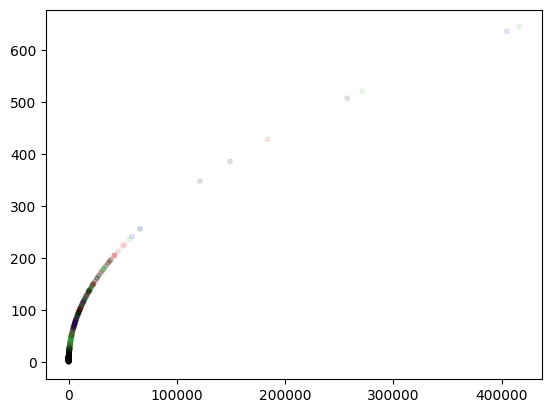

In [177]:
plt.scatter(meansK, stdsK, c=y_ar_K_colors, alpha=0.1, s=10)
plt.show()
plt.scatter(meansK, varsK, c=y_ar_K_colors, alpha=0.1, s=10)
plt.show()
plt.scatter(varsK, stdsK, c=y_ar_K_colors, alpha=0.1, s=10)
plt.show()

Accuracy: 0.77
F1-score: 0.74
Confusion Matrix:
[[965  81   0   2   2   0]
 [ 95 189   0   3   0   0]
 [ 46  36   0   1   0   0]
 [ 23  13   0   2   0   0]
 [  7  19   0   0   0   0]
 [  7   3   0   0   0   0]]


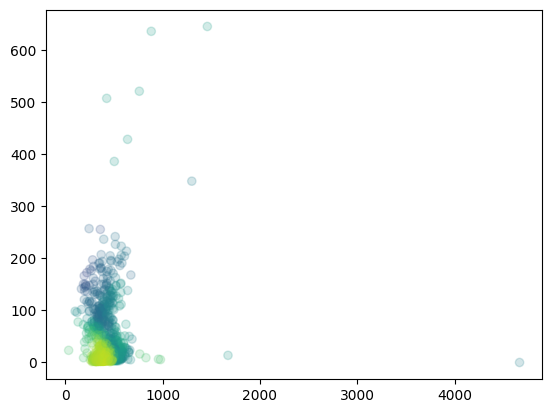

Accuracy: 0.80
F1-score: 0.76
Confusion Matrix:
[[1019   27    0    3    1    0]
 [ 104  181    0    2    0    0]
 [  69   13    0    1    0    0]
 [  30    7    0    1    0    0]
 [  14   12    0    0    0    0]
 [   8    2    0    0    0    0]]


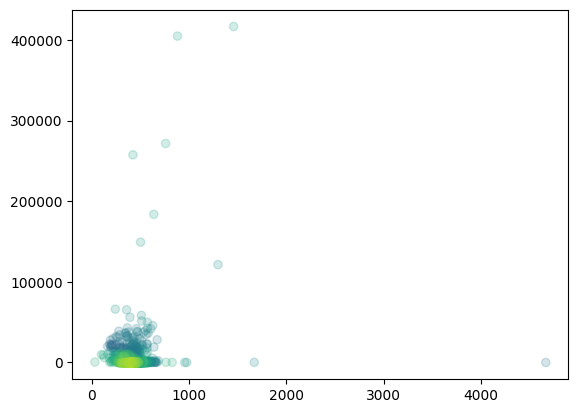

Accuracy: 0.70
F1-score: 0.61
Confusion Matrix:
[[1024   23    0    3    0    0]
 [ 260   25    0    2    0    0]
 [  72   10    0    1    0    0]
 [  32    5    0    1    0    0]
 [  14   12    0    0    0    0]
 [   9    1    0    0    0    0]]


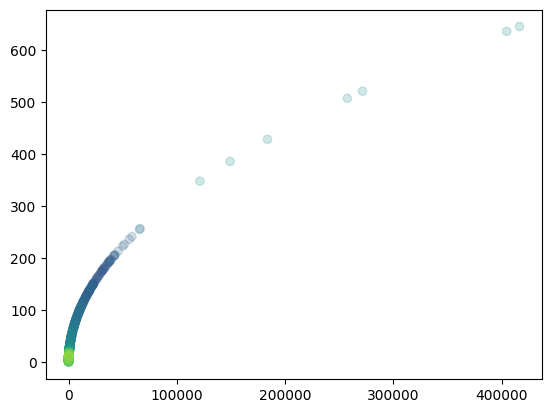

In [176]:
bayes(meansK, stdsK, torch.tensor([[int(i[0])] for i in y_ar_K]))
bayes(meansK, varsK, torch.tensor([[int(i[0])] for i in y_ar_K]))
bayes(varsK, stdsK, torch.tensor([[int(i[0])] for i in y_ar_K]))

Accuracy: 0.75
F1-score: 0.74
Confusion Matrix:
[[130  20]
 [ 55  90]]


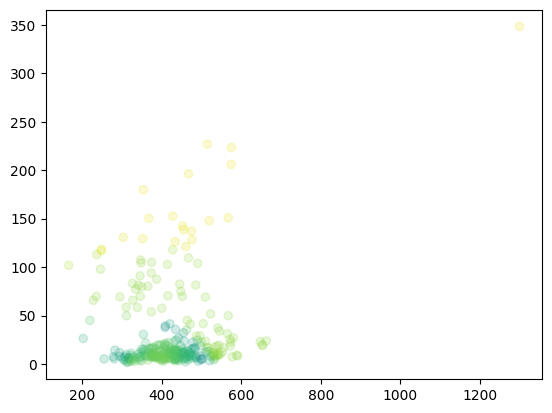

Accuracy: 0.69
F1-score: 0.67
Confusion Matrix:
[[138  12]
 [ 79  66]]


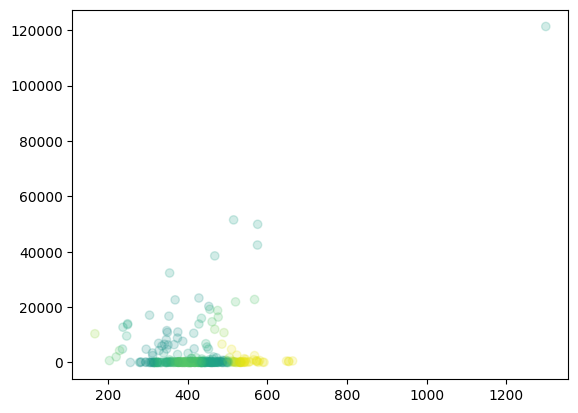

Accuracy: 0.63
F1-score: 0.62
Confusion Matrix:
[[119  31]
 [ 77  68]]


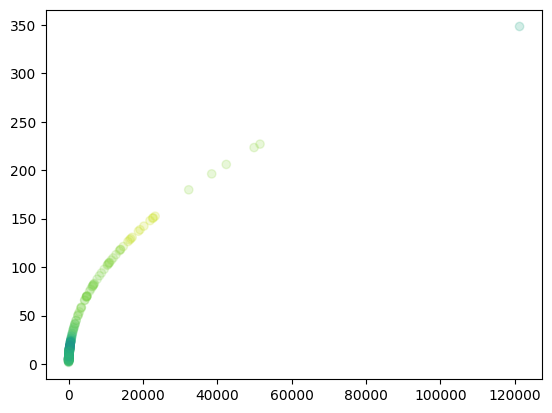

In [148]:
bayes(meansK, stdsK, yK)
bayes(meansK, varsK, yK)
bayes(varsK, stdsK, yK)

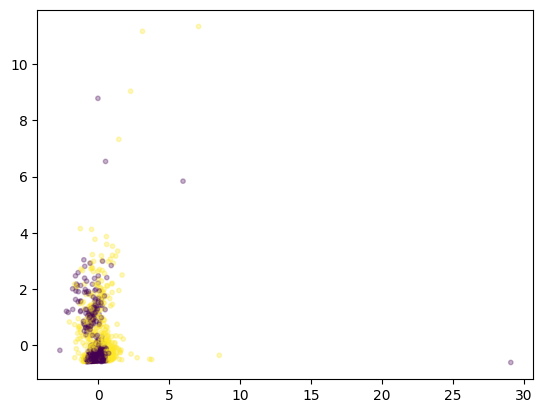

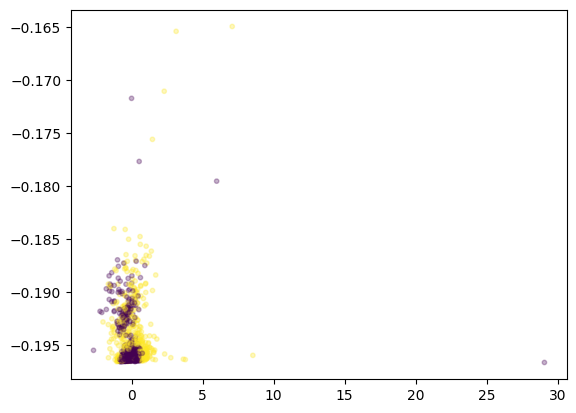

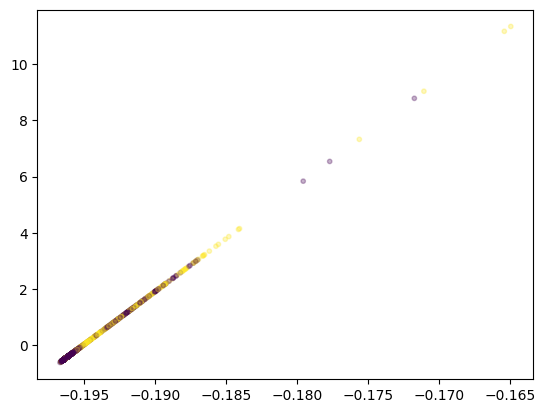

In [205]:
meansK_ = meansK
stdsK_ = stdsK
varsK_ = varsK
y_ar_K_ = y_ar_K

meansK = []
stdsK = []
varsK = []
y_ar_K = []

for z in range(len(meansK_)):
    if not(np.isnan(meansK_[z]) or np.isnan(stdsK_[z])):
        meansK.append(meansK_[z])
        stdsK.append(stdsK_[z])
        varsK.append(varsK_[z])
        y_ar_K.append(y_ar_K_[z].tolist())

y_ar_K = torch.tensor(y_ar_K)

mm = np.mean(meansK, axis=0)
ms = np.std(meansK, axis=0)

sm = np.mean(stdsK, axis=0)
ss = np.std(stdsK, axis=0)

vm = np.mean(varsK, axis=0)
vs = np.std(varsK, axis=0)

meansK_ = (meansK - mm) / ms
stdsK_ = (stdsK - sm) / ss
varsK_ = (stdsK - vm) / vs

plt.scatter(meansK_, stdsK_, c=y_ar_K, alpha=0.3, s=10)
plt.show()
plt.scatter(meansK_, varsK_, c=y_ar_K, alpha=0.3, s=10)
plt.show()
plt.scatter(varsK_, stdsK_, c=y_ar_K, alpha=0.3, s=10)
plt.show()

Accuracy: 0.81
F1-score: 0.81
Confusion Matrix:
[[906 144]
 [144 300]]


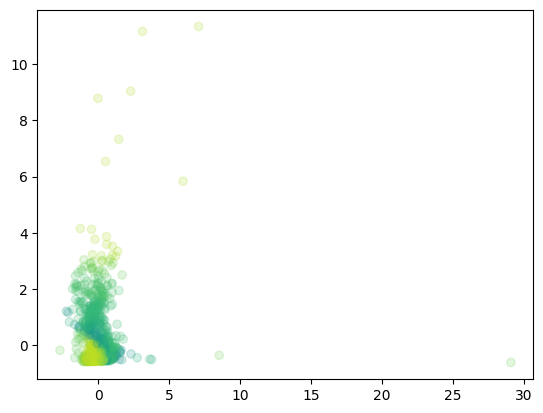

Accuracy: 0.81
F1-score: 0.81
Confusion Matrix:
[[906 144]
 [144 300]]


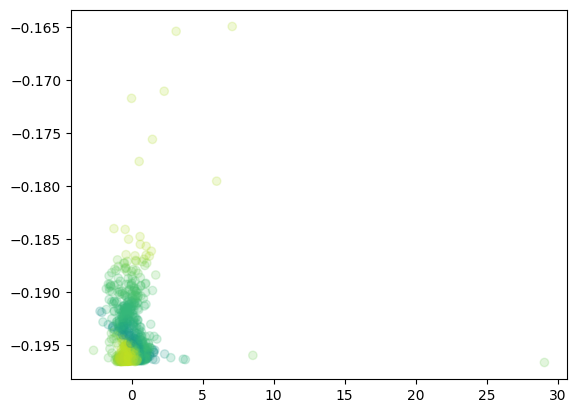

Accuracy: 0.76
F1-score: 0.76
Confusion Matrix:
[[895 155]
 [203 241]]


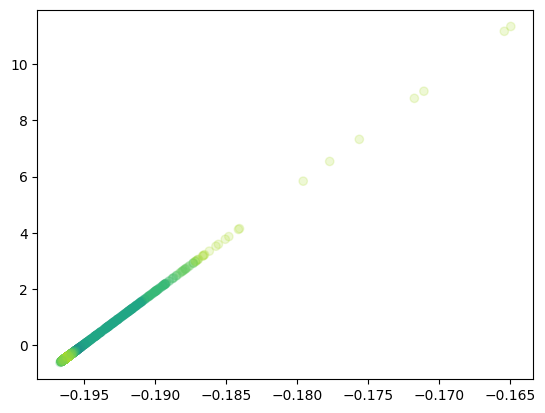

In [209]:
bayes(meansK_, stdsK_, y_ar_K)
bayes(meansK_, varsK_, y_ar_K)
bayes(varsK_, stdsK_, y_ar_K)

In [121]:
for i in range(len(meansK)):
    if np.isnan(meansK[i]) or np.isnan(stdsK[i]):
        print(i)

424
797
894


In [65]:
r_peaks_all = find_R_peaks(signals_transformed, 2, 4, 83)

r_peaks_all_delta = []
means = []
stds = []
vars = []

for r_peaks in r_peaks_all:
    r_peaks_delta = []
    for j in range(len(r_peaks) - 1):
        r_peaks_delta.append(r_peaks[j + 1] - r_peaks[j])
    r_peaks_all_delta.append(r_peaks_delta)
    
    means.append(np.mean(r_peaks_delta))
    stds.append(np.std(r_peaks_delta))
    vars.append(np.var(r_peaks_delta))

ns = []

for i in range(len(r_peaks_all)):
    ns.append(len(r_peaks_all[i]))

ns = np.unique(ns)

In [66]:
ns

array([ 4,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
       24, 25, 28, 30, 32, 33, 37])

In [73]:
for i in range(len(r_peaks_all)):
    if len(r_peaks_all[i]) == 8:
        print(i)

37
53
98
158
216
250
291


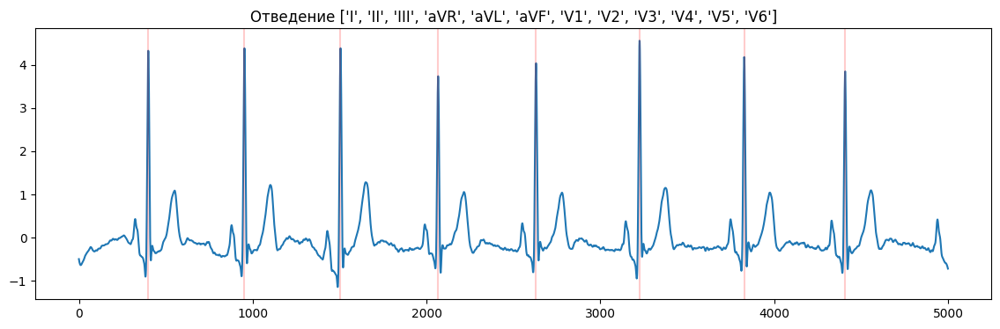

In [ ]:
visualize_channel_with_peaks(signals_transformed, r_peaks_all, 53, 0)

In [88]:
q_peaks_all = find_Q_peaks(signals_transformed, r_peaks_all)

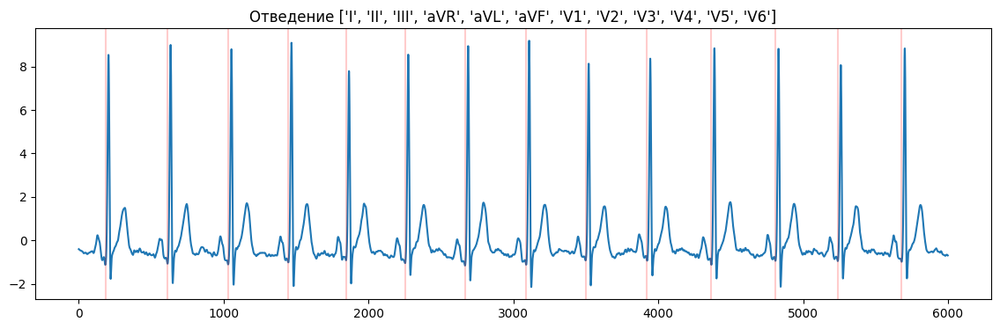

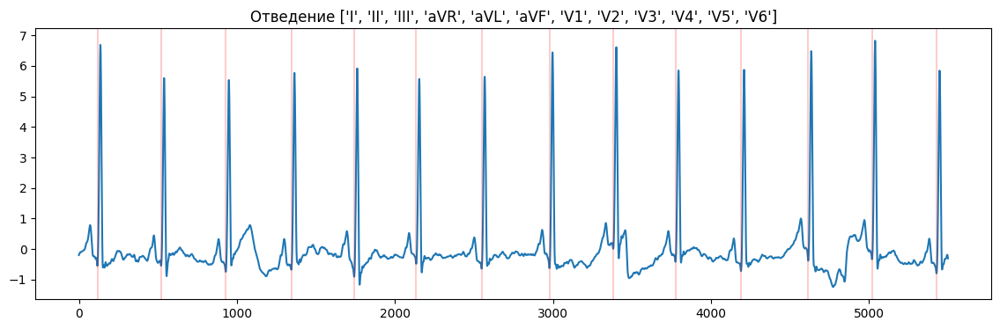

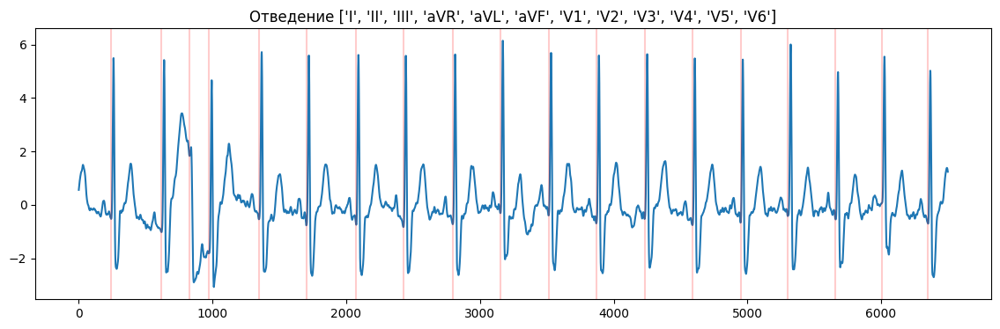

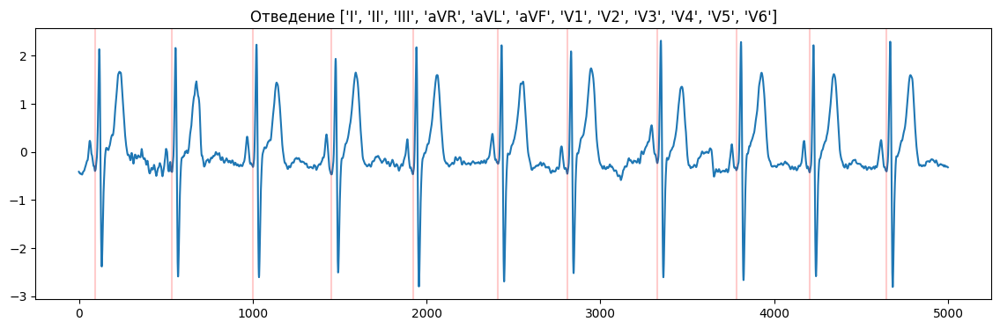

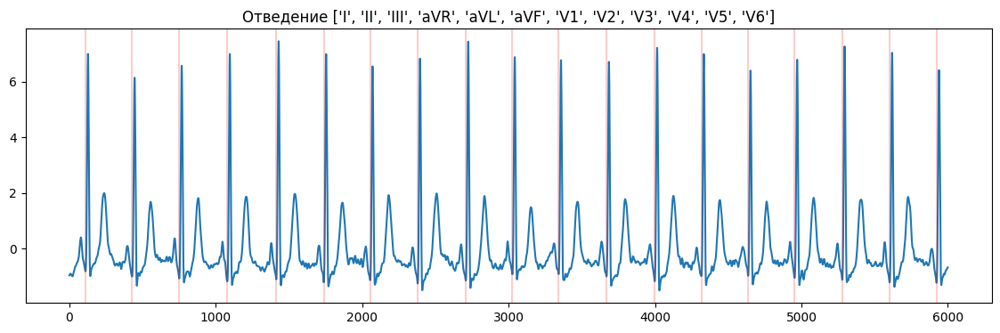

...

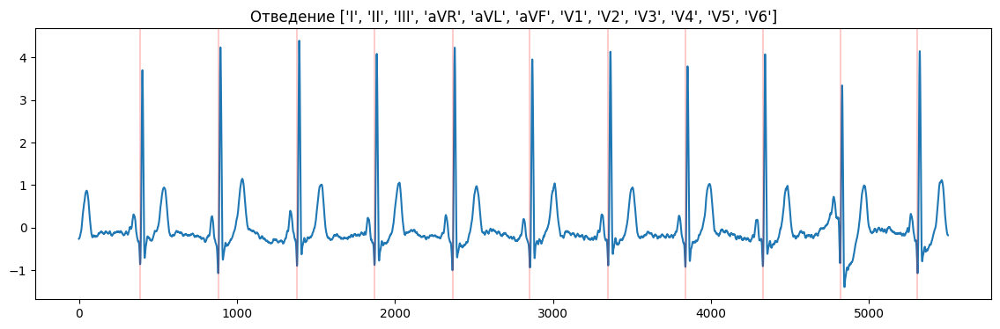

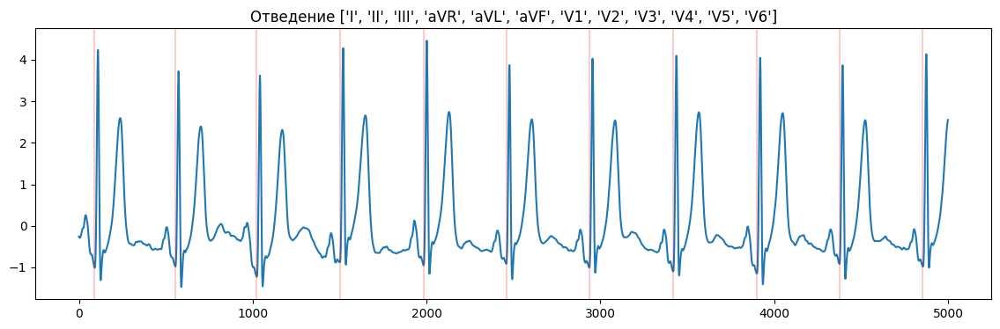

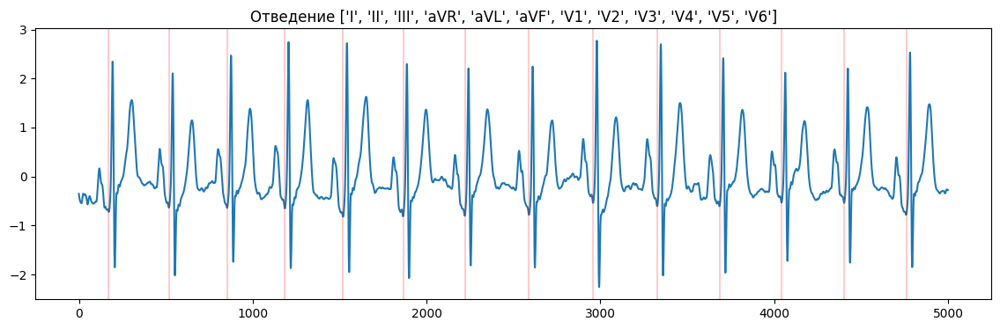

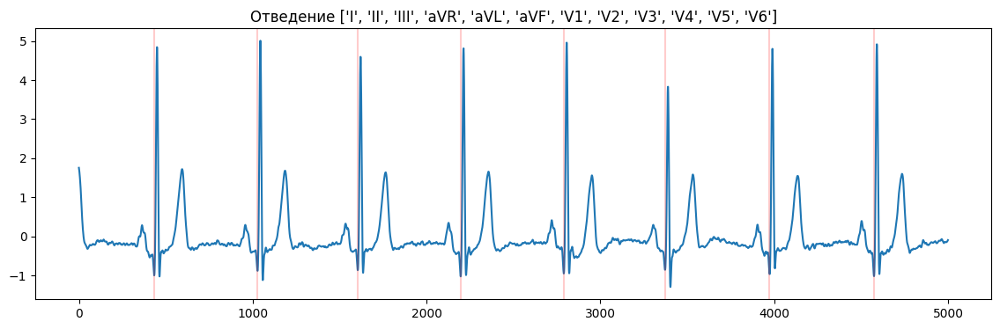

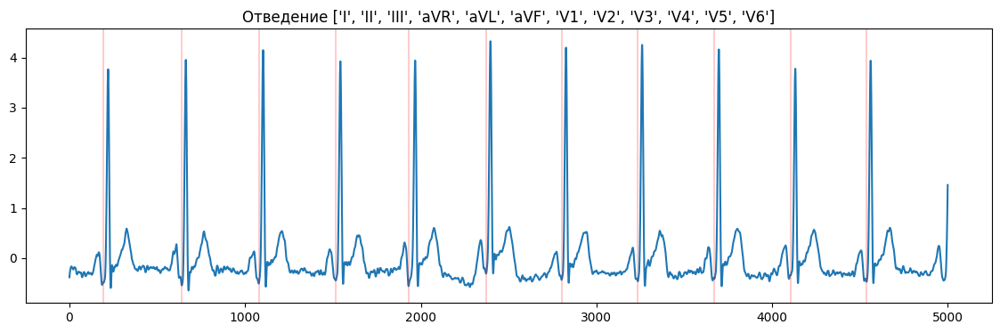

In [89]:
for i in range(0,100):
    visualize_channel_with_peaks(signals_transformed, q_peaks_all, i, 0)

In [107]:
s_peaks_all = find_S_peaks(signals_transformed, r_peaks_all)

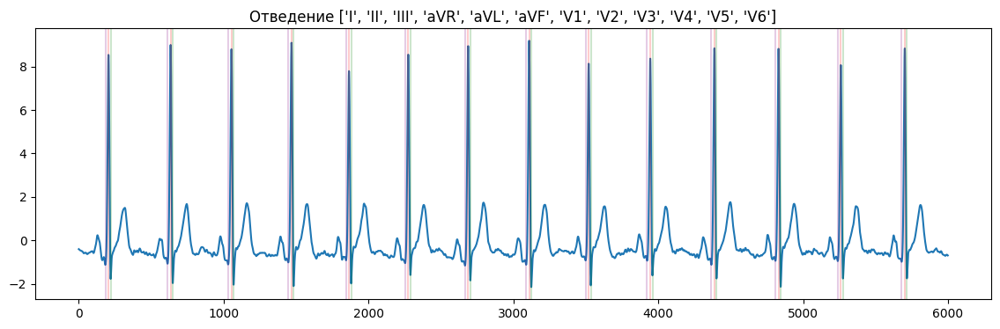

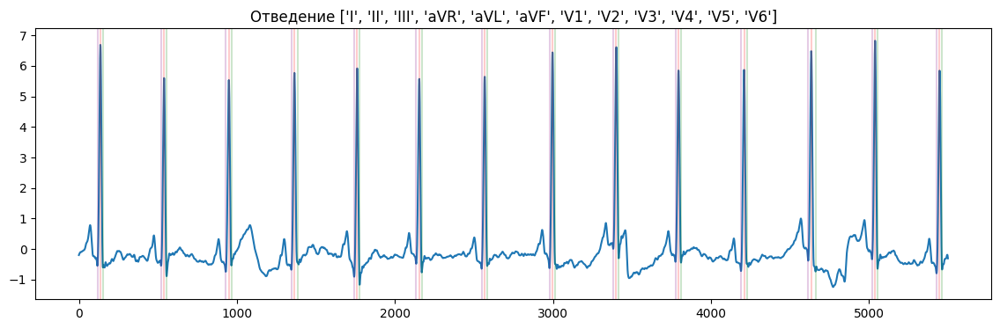

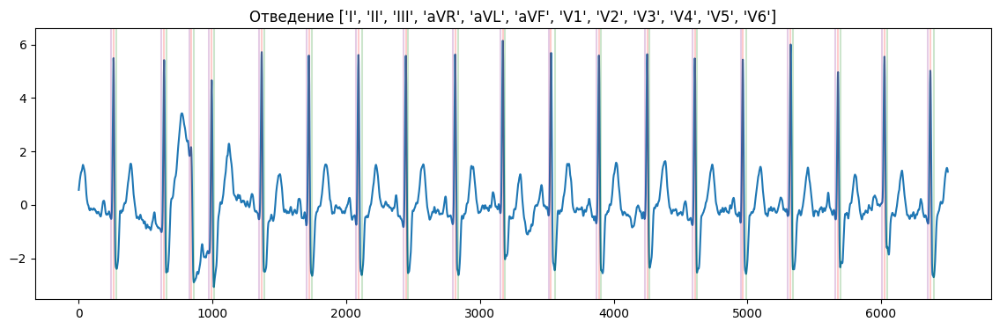

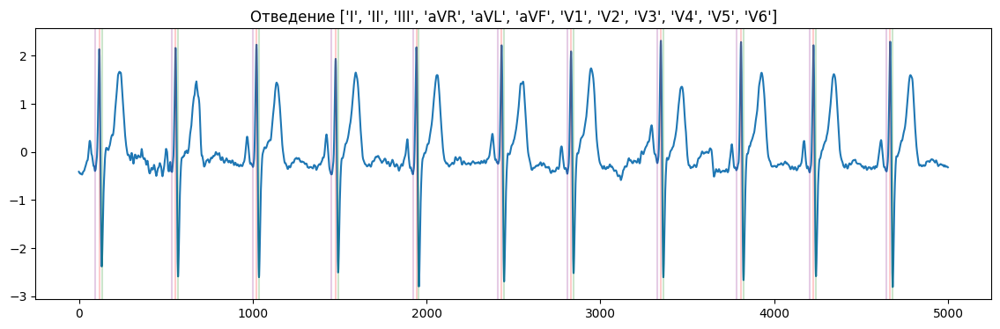

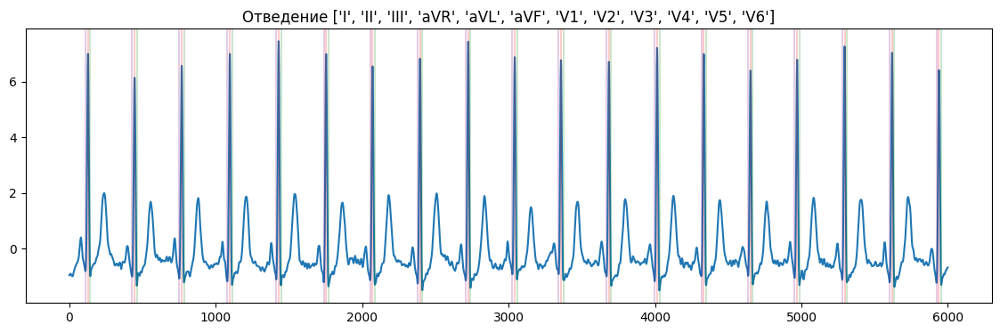

...

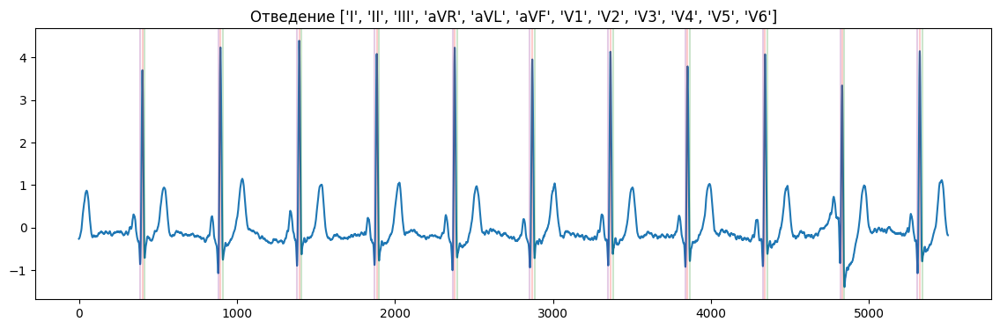

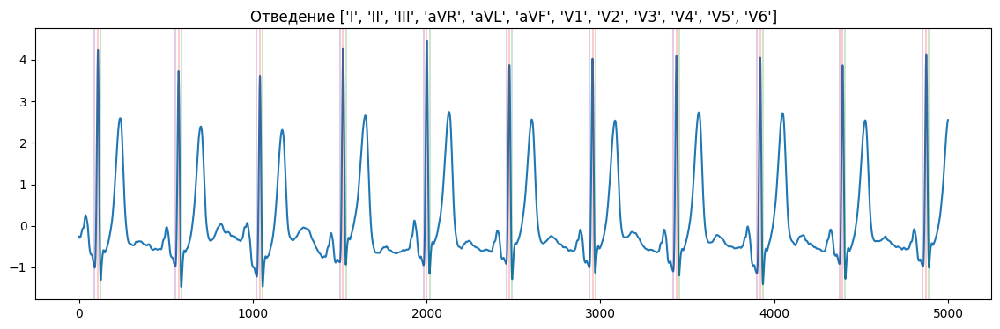

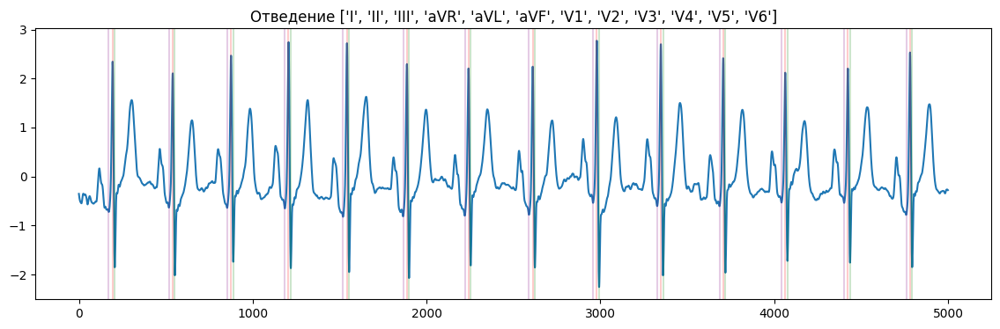

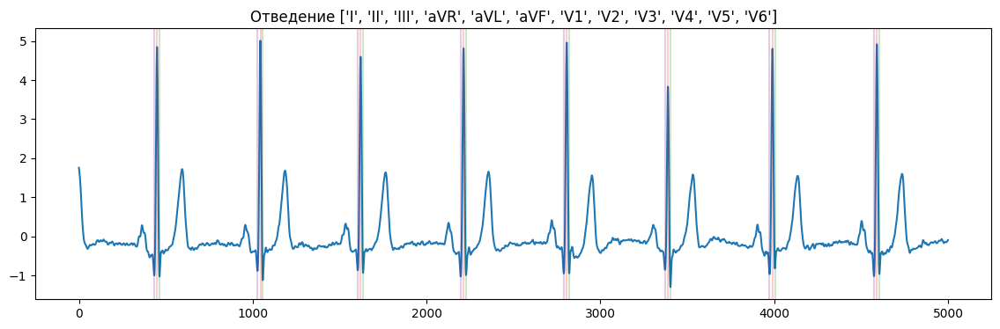

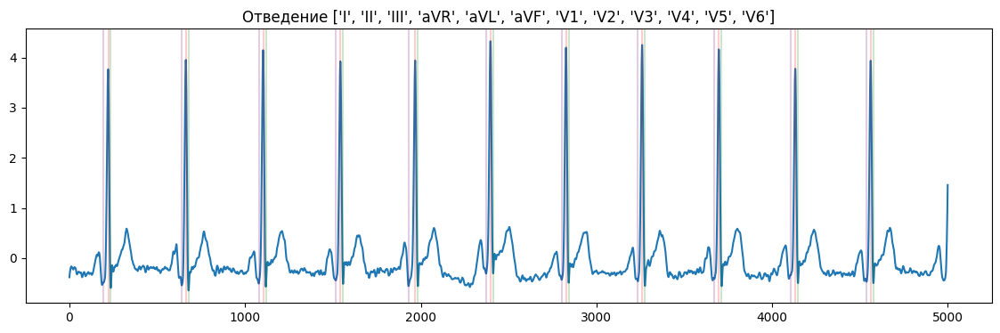

In [109]:
for i in range(0,100):
    visualize_channel_with_peaks(signals_transformed, Q_peaks=q_peaks_all, R_peaks=r_peaks_all, S_peaks=s_peaks_all, index=i, channel=0)